# Self-Driving Car Engineer Nanodegree

## Project 2: **Advanced Lane Finding**




Technical task:
    1) Calibrate the camera based on the provided calibration images. Correct the original image for distortion using the camera matrix obtained during the step 1)
    2) Binorize the image by means of color and/or gradient thresholding and binary transformation
    3) Perform a perspective transformation of the image to obtain a "bird's-eye view" of the lane
    4) Detect pixels corresponding to the lane markings
    5) Find the coefficients of the fitted polynom and calculate the line curvature (in meters). Find the vehicle position within the lane (in meters).
    6) Warp the found lane coordinates back into the original image and visualize them.
    
    
    
For a standout submission, you should follow the suggestion in the lesson to not just search blindly for the lane lines in each frame of video, but rather, once you have a high-confidence detection, use that to inform the search for the position of the lines in subsequent frames of video. For example, if a polynomial fit was found to be robust in the previous frame, then rather than search the entire next frame for the lines, just a window around the previous detection could be searched. This will improve speed and provide a more robust method for rejecting outliers.

For an additional improvement you should implement outlier rejection and use a low-pass filter to smooth the lane detection over frames, meaning add each new detection to a weighted mean of the position of the lines to avoid jitter.

If you really want to go above and beyond, implement these methods on the challenge videos as well, or on your own videos you've recorded yourself.

    

Load the necessary libraries

In [24]:
import cv2
import numpy as np
import glob
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

Step 1: Calibrate and correct the provided images for distortion. Save the undistorted images into the 'output_images' folder.

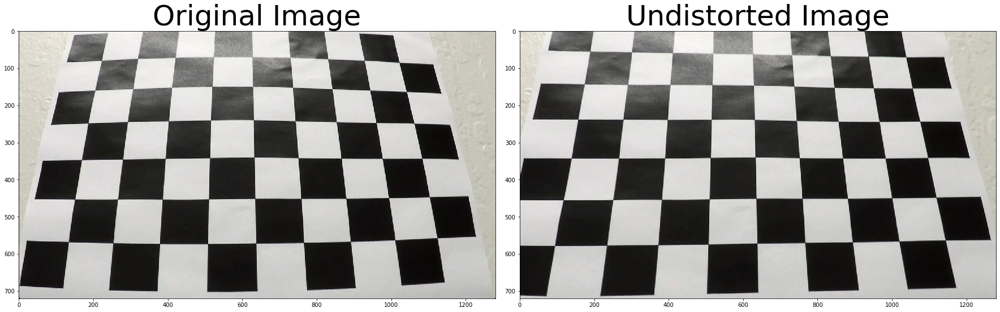

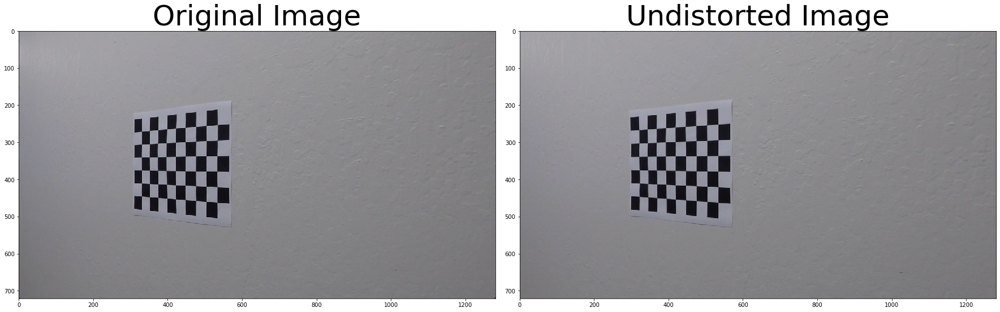

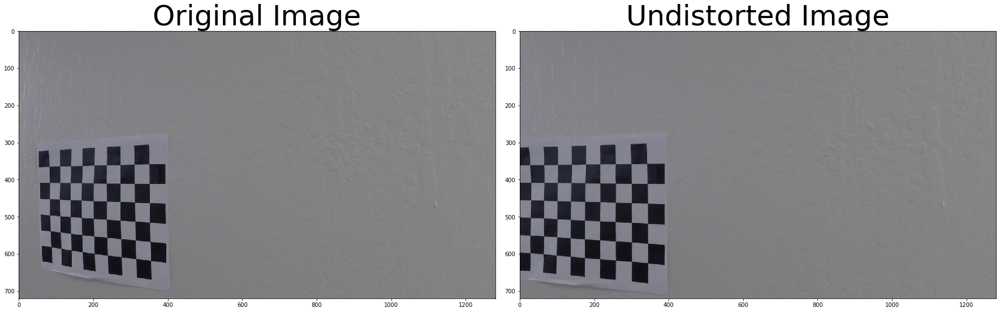

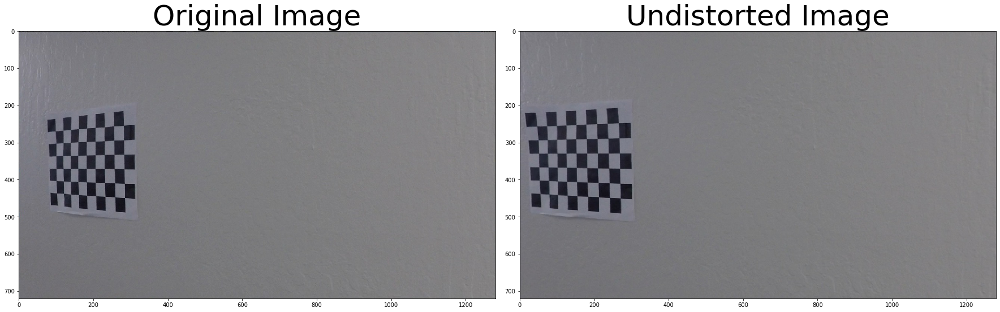

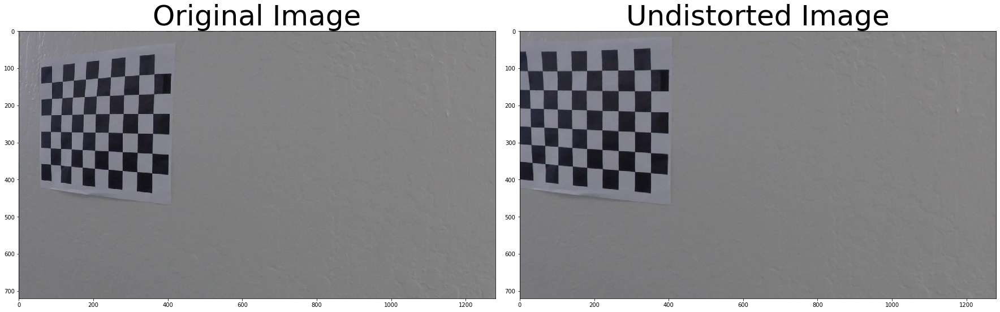

...

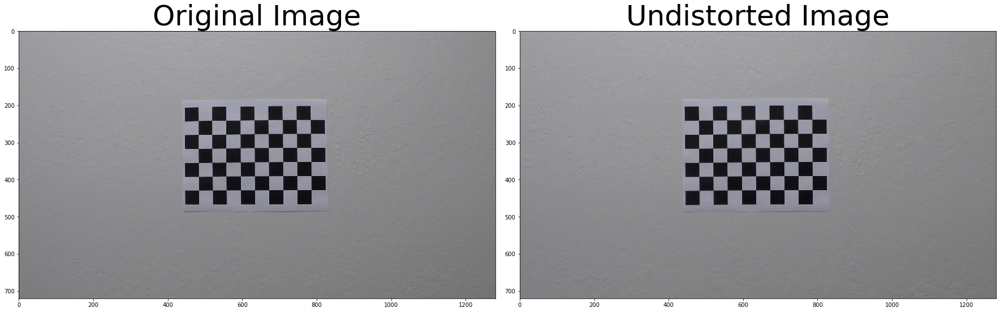

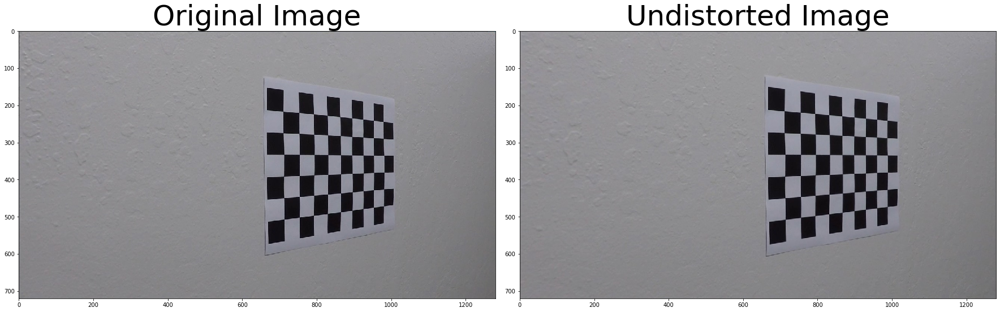

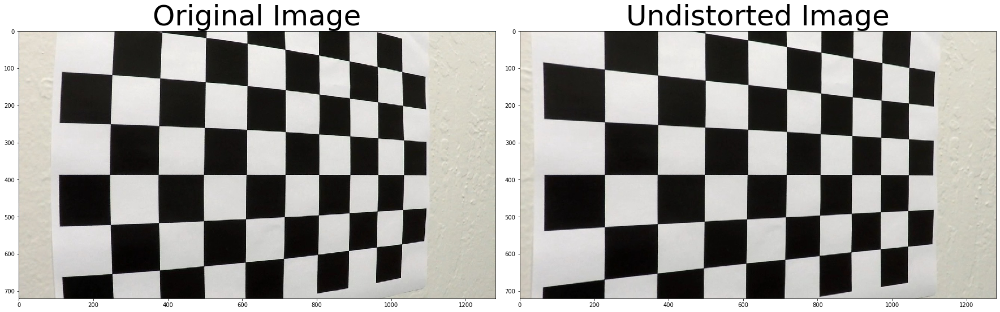

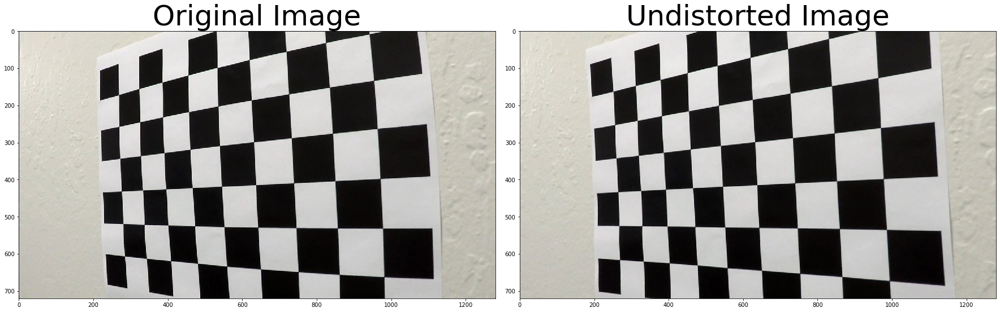

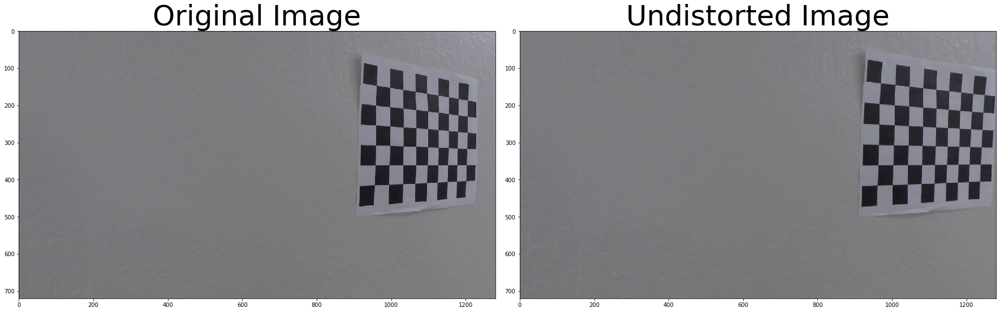

In [25]:
nx = 9 # number of inside corners in x
ny = 6 # number of inside corners in y

imgpoints = []
objpoints = []
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9, 0:6].T.reshape(-1,2)


#read images
filenames = glob.glob('camera_cal/calibration*.jpg')
i = 1
for file in filenames:
    # Read in an image
    img = mpimg.imread(file)
    # Convert to grayscale
    grayscale_img = cv2.cvtColor(img,cv2.COLOR_RGB2GRAY)
    # Find corners
    ret, corners = cv2.findChessboardCorners(grayscale_img, (9,6), None)

    if ret == True:
        imgpoints.append(corners)
        objpoints.append(objp)
    #Calibrate the camera
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, grayscale_img.shape[::-1], None, None)
    #Undistort the original image
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(undist)
    ax2.set_title('Undistorted Image', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    file_new = ('output_images/calibration' + str(i) + '.jpg')
    i+=1
    cv2.imwrite(file_new, undist)

Undistort the real traffic images using the intrinsic camera calibration parameters obtained earlier.

Here, a median filter was used in order to get minimize the severeness of the artefacts caused by the damaged road

In [26]:
import math

def color_grad_thresholding(img, s_thresh, r_thresh, h_thresh, sx_thresh):
    img = np.copy(img)
    #img = cv2.medianBlur(img, 5)
    img = cv2.GaussianBlur(img, (7, 7), 0)
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    h_channel = hls[:,:,0]
    l_channel = hls[:,:,1]
    s_channel = hls[:,:,2]
    r_channel = img[:,:,0]
    
    # Sobel x
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    
    # Threshold x gradient
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1])] = 1
    
    # Threshold color channel
    s_binary = np.zeros_like(s_channel)
    l_binary = np.zeros_like(l_channel)
    r_binary = np.zeros_like(r_channel)
    h_binary = np.zeros_like(h_channel)
    r_binary[(r_channel >= r_thresh[0]) & (r_channel < r_thresh[1])] = 1
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1
    h_binary[(l_channel >= h_thresh[0]) & (l_channel <= h_thresh[1])] = 1
    # Stack each channel
    color_binary = cv2.bitwise_or(s_binary, sxbinary)
    color_binary2 = cv2.bitwise_or(r_binary, h_binary)
    color_binary_final = cv2.bitwise_or(color_binary, color_binary2)
    return color_binary_final

def roi_vertices(img):
    #Vertices
    width = img.shape[1]
    height = img.shape[0]
    left_bottom_x = math.floor(0.05*width)
    left_bottom_y = math.floor(height)
    left_top_x = math.floor(0.45*width)
    left_top_y = math.floor(0.60*height)
    right_top_x = math.floor(0.54*width)
    right_top_y = math.floor(0.60*height)
    right_bottom_x = math.floor(0.95*width)
    right_bottom_y = math.floor(height)
    vertices = np.array([[(left_bottom_x, left_bottom_y),(left_top_x, left_top_y), (right_top_x, right_top_y), (right_bottom_x, right_bottom_y)]], dtype=np.int32)
    return vertices

def region_of_interest(img):
    #defining a blank mask to start with
    mask = np.zeros_like(img)
    vertices = roi_vertices(img)
    #defining a 3 channel or 1 channel color to fill the mask with depending on the input image
    if len(img.shape) > 2:
        channel_count = img.shape[2]  # i.e. 3 or 4 depending on your image
        ignore_mask_color = (255,) * channel_count
    else:
        ignore_mask_color = 255
    
    #filling pixels inside the polygon defined by "vertices" with the fill color    
    cv2.fillPoly(mask, vertices, ignore_mask_color)
    
    #returning the image only where mask pixels are nonzero
    masked_image = cv2.bitwise_and(img, mask)
    return masked_image



As tuning thresholds might turn into a lengthly and painful procedure, a python widget with an "interact" functionality were utilized. This widget allows for a flexible way of tuning by employing sliders for each of the threshold. By calling the thresholding function and visualizing the resulting image after each slider position's modification the user gets a possibility to evaluate the potential of the used thresholds. As many computer vision applications still rely on a subjective verification, this way might prove the easiest in order to achieve the optimum for the function of interest.

For more information on the "interact" ipywidget refer to https://ipywidgets.readthedocs.io/en/latest/examples/Using%20Interact.html

In [27]:
from ipywidgets import widgets
from ipywidgets import interact

def tuning_thresholds(x_s, y_s, x_r, y_r, x_h, y_h, grad_x_thresh, grad_y_thresh):
    color_thresh = color_grad_thresholding(image, s_thresh=(x_s, y_s),r_thresh=(x_r, y_r),h_thresh=(x_h, y_h), sx_thresh=(grad_x_thresh, grad_y_thresh))
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()

    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=40)

    ax2.imshow(color_thresh*255)
    ax2.set_title('Tuning Result', fontsize=40)
    
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)


#file = 'test_images/straight_lines1.jpg'
#file = 'test_images/test.jpg'
file = 'test_images/test5.jpg'
img = mpimg.imread(file)
image = cv2.undistort(img, mtx, dist, None, mtx)

   
interact(tuning_thresholds, x_s=widgets.IntSlider(min=0, max=255, step=1, value = 200, 
                                                continuous_update=False, description="Min Sat:"), 
         y_s=widgets.IntSlider(min=0,max=255, step=1,value=255, description="Max Sat:"),
         x_r=widgets.IntSlider(min=0, max=255, step=1, value = 219, 
                                                continuous_update=False, description="Min Red:"), 
        y_r=widgets.IntSlider(min=0,max=255, step=1,value=230, description="Max Red:"),
        x_h=widgets.IntSlider(min=0,max=255, step=1,value=229, description="Min Hue:"),
        y_h=widgets.IntSlider(min=0,max=255, step=1,value=235, description="Max Hue:"),
        grad_x_thresh=widgets.IntSlider(min=0, max=255, step=1, value=25, description="Min gradX: "),
        grad_y_thresh=widgets.IntSlider(min=0, max=255, step=1, value=132, description="Max gradX: "))

interactive(children=(IntSlider(value=200, continuous_update=False, description='Min Sat:', max=255), IntSlide…

<function __main__.tuning_thresholds(x_s, y_s, x_r, y_r, x_h, y_h, grad_x_thresh, grad_y_thresh)>

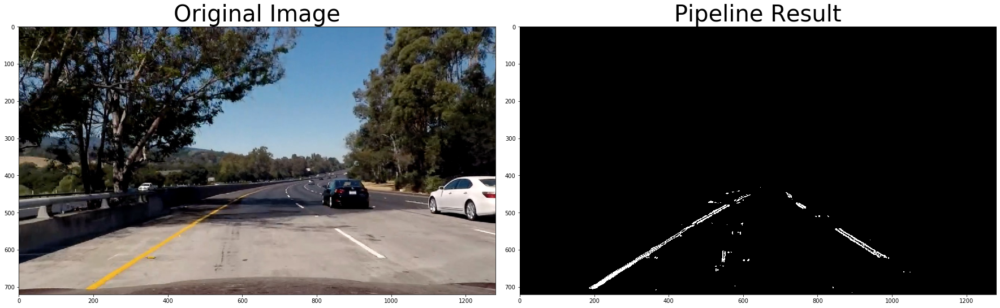

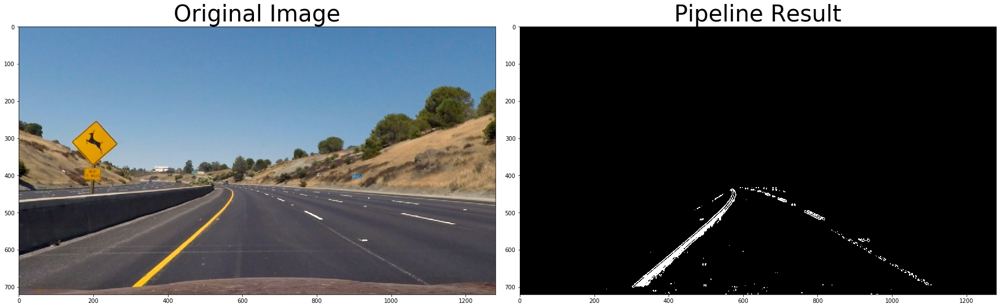

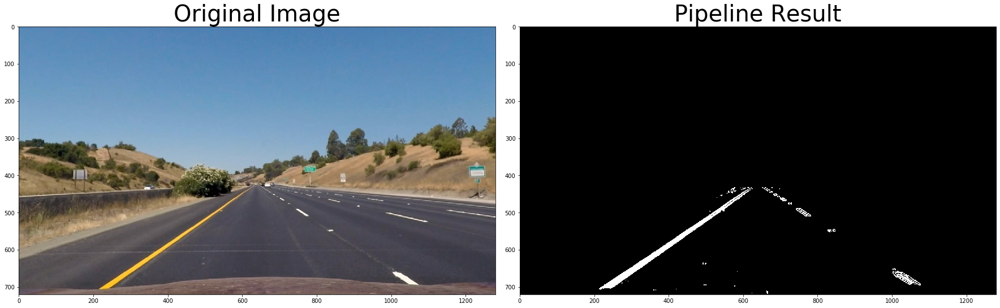

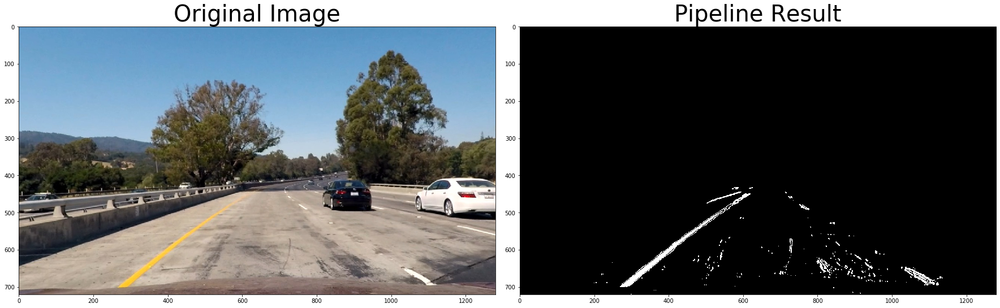

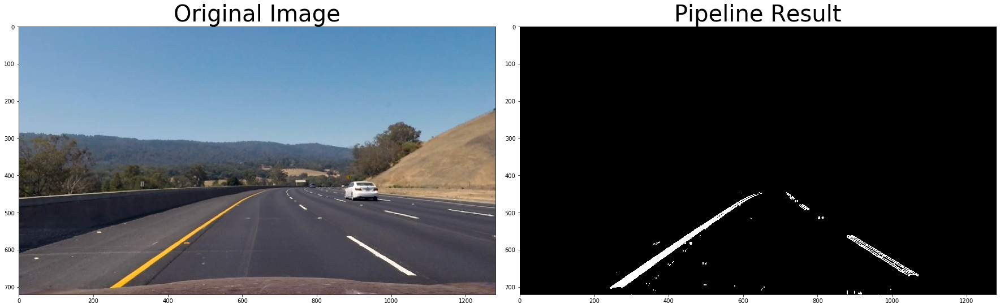

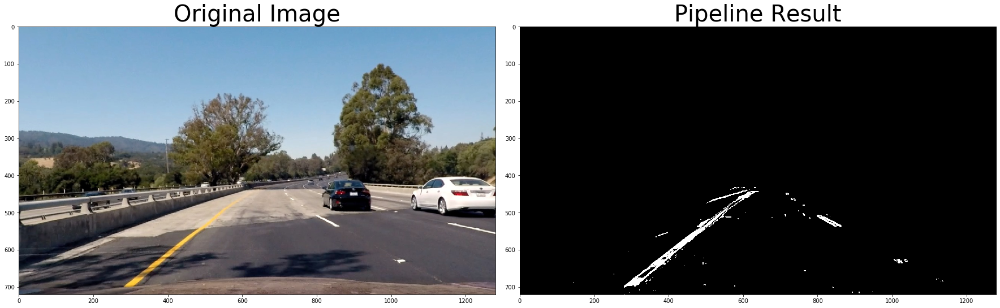

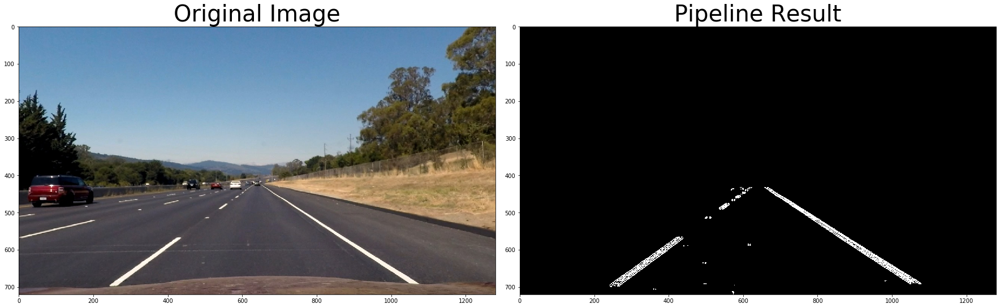

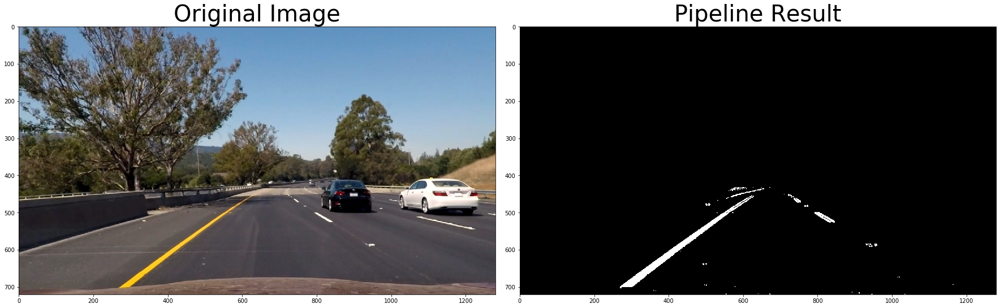

In [35]:
files = glob.glob('test_images/straight_lines*.jpg')
i = 0
for file in files:
    img = mpimg.imread(file)
    img = cv2.undistort(img, mtx, dist, None, mtx)
    result = color_grad_thresholding(img, (200, 255), (219, 230), (229, 235), (25, 132))
    roi_image = region_of_interest(result) 
    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()

    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=40)

    ax2.imshow(roi_image, cmap='gray')
    ax2.set_title('Pipeline Result', fontsize=40)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    file_new_thresh = ('output_images/straight_lines' + str(i) + '.jpg')
    i+=1
    cv2.imwrite(file_new_thresh, roi_image)

files = glob.glob('test_images/test*.jpg')
i = 0
for file in files:
    img = mpimg.imread(file)
    img = cv2.undistort(img, mtx, dist, None, mtx)
    result = color_grad_thresholding(img, (200, 255), (219, 230), (229, 235), (25, 132))
    roi_image = region_of_interest(result)
    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()

    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=40)

    ax2.imshow(roi_image, cmap='gray')
    ax2.set_title('Pipeline Result', fontsize=40)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    file_new_thresh = ('output_images/test' + str(i) + '.jpg')
    i+=1
    cv2.imwrite(file_new_thresh, roi_image*255)

Choose selected points in an image and perform a perspective transformation on it

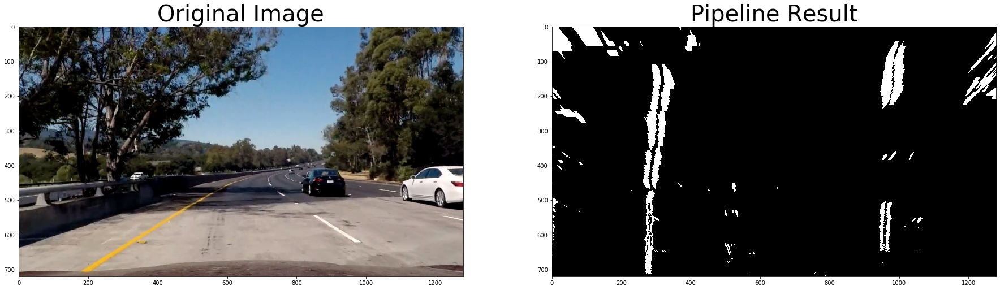

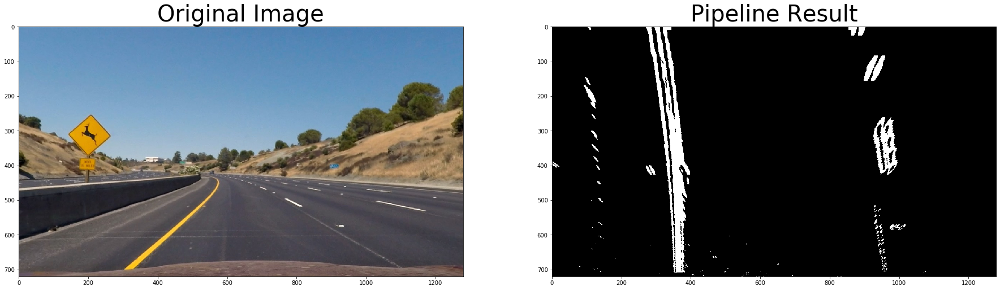

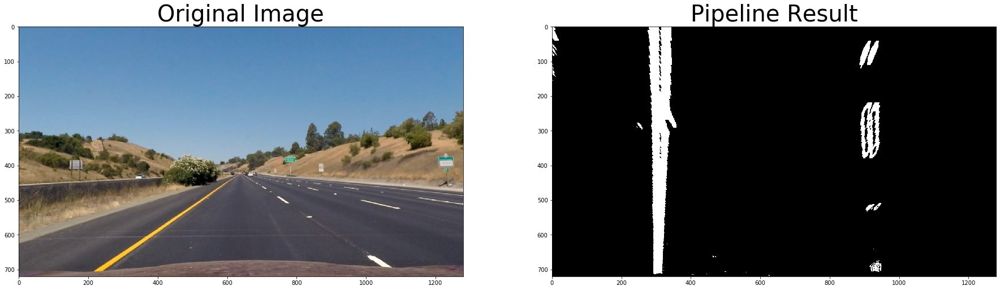

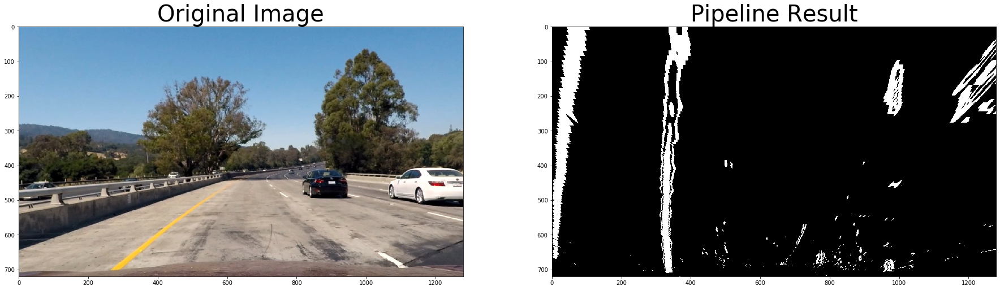

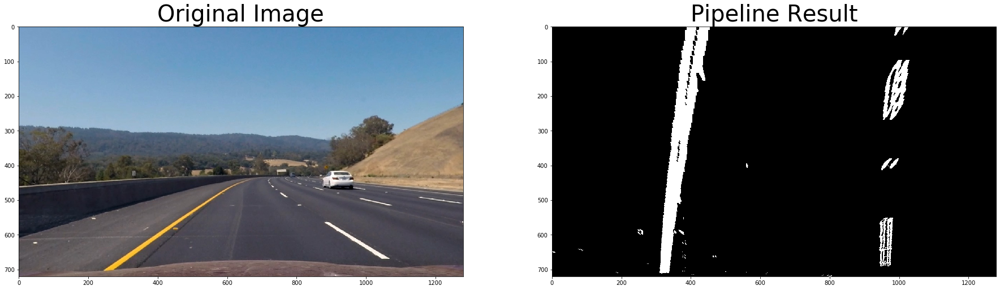

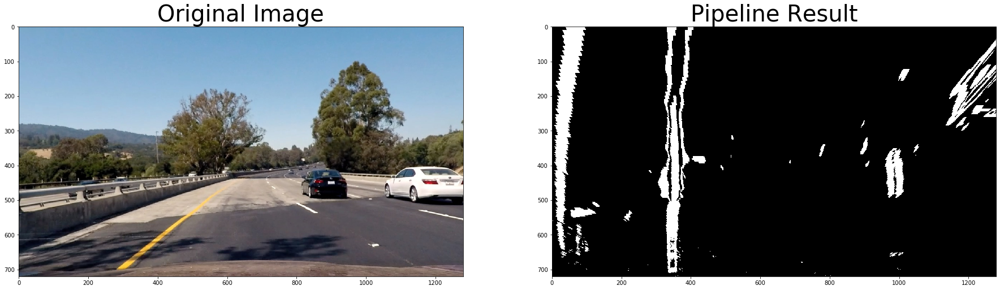

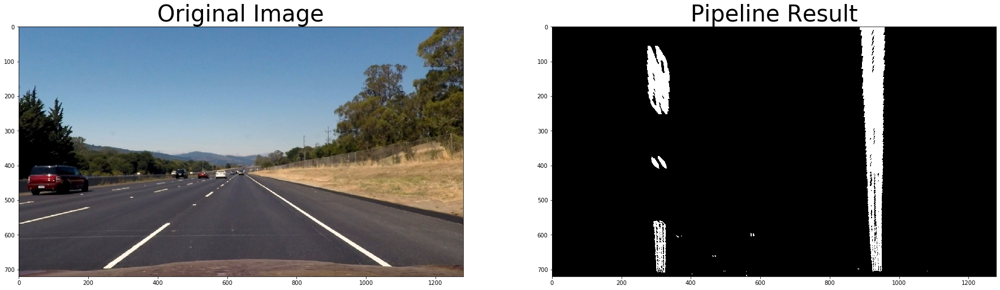

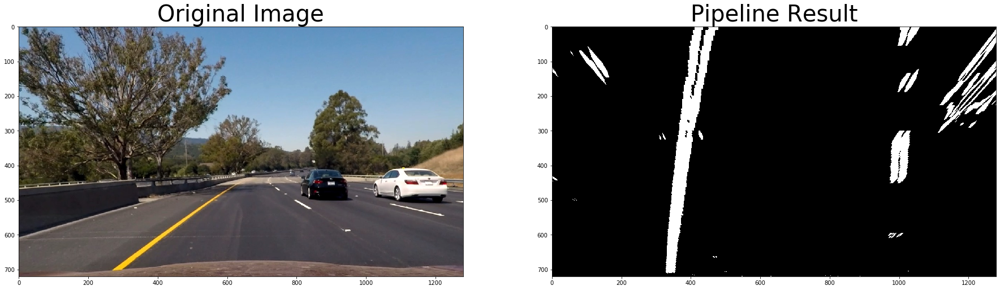

In [29]:
#Define the source and destination points
#src_bottom_left = [271,674]
#src_top_left = [590, 454]
#src_top_left = [605,443]
#src_top_right = [673,443]
#src_bottom_right = [1018,664]

src_bottom_left = [200,720]
src_bottom_right = [1200, 720]
src_top_left = [565, 470]
src_top_right = [740, 470]

dst_bottom_left = [300,720]
dst_bottom_right = [1000, 720]
dst_top_left = [300, 1]
dst_top_right = [1000, 1]

#dst_bottom_left = [300,720]
#dst_top_left = [300, 200]
#dst_top_right = [1020, 200]
#dst_bottom_right = [1020, 720]

src = np.float32([src_bottom_left, src_top_left, src_top_right, src_bottom_right])
dst = np.float32([dst_bottom_left, dst_top_left, dst_top_right, dst_bottom_right])

files = glob.glob('test_images/straight_lines*.jpg')
i = 0
for file in files:
#Open a test image
    img = mpimg.imread(file)
    img = cv2.undistort(img, mtx, dist, None, mtx)
    thresholded = color_grad_thresholding(img, (200, 255), (219, 230), (229, 235), (25, 132))

    # Given src and dst points, calculate the perspective transform matrix
    M = cv2.getPerspectiveTransform(src, dst)
    # Warp the image using OpenCV warpPerspective()
    warped = cv2.warpPerspective(thresholded, M, (img.shape[1], img.shape[0]))

    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=40)

    ax2.imshow(warped, cmap='gray')
    ax2.set_title('Pipeline Result', fontsize=40)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    file_new_warped = ('output_images/straight_lines_warped' + str(i) + '.jpg')
    i+=1
    cv2.imwrite(file_new_warped, warped*255)
    
files = glob.glob('test_images/test*.jpg')
i = 0
for file in files:
    img = mpimg.imread(file)
    img = cv2.undistort(img, mtx, dist, None, mtx)
    thresholded = color_grad_thresholding(img, (200, 255), (219, 230), (229, 235), (25, 132))

    # Given src and dst points, calculate the perspective transform matrix
    M = cv2.getPerspectiveTransform(src, dst)
    # Warp the image using OpenCV warpPerspective()
    warped = cv2.warpPerspective(thresholded, M, (img.shape[1], img.shape[0]))

    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=40)

    ax2.imshow(warped, cmap='gray')
    ax2.set_title('Pipeline Result', fontsize=40)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    file_new_warped = ('output_images/test_warped' + str(i) + '.jpg')
    i+=1
    cv2.imwrite(file_new_warped, warped*255)


In [30]:
def calibration():
    nx = 9 # number of inside corners in x
    ny = 6 # number of inside corners in y

    imgpoints = []
    objpoints = []
    objp = np.zeros((6*9,3), np.float32)
    objp[:,:2] = np.mgrid[0:9, 0:6].T.reshape(-1,2)


    #read images
    file = 'camera_cal/calibration2.jpg'
    img = mpimg.imread(file)
    # Convert to grayscale
    grayscale_img = cv2.cvtColor(img,cv2.COLOR_RGB2GRAY)
    # Find corners
    ret, corners = cv2.findChessboardCorners(grayscale_img, (9,6), None)

    if ret == True:
        imgpoints.append(corners)
        objpoints.append(objp)
    #Calibrate the camera
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, grayscale_img.shape[::-1], None, None)
    return mtx, dist

def find_lane_pixels(binary_warped):
    binary_warped = cv2.medianBlur(binary_warped, 7)
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint
    #plt.plot(histogram)
    # HYPERPARAMETERS
    # Choose the number of sliding windows
    nwindows = 9
    # Set minimum number of pixels found to recenter window
    minpix = 70
    margin = 100
    
    # Create an output image to draw on and visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))
    
    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(binary_warped.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base
    
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2)
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2) 
        
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices (previously was a list of lists of pixels)
    try:
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    except ValueError:
        # Avoids an error if the above is not implemented fully
        pass

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [100, 200, 255]

    return leftx, lefty, rightx, righty, out_img

def fit_poly(img_shape, leftx, lefty, rightx, righty):
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    # Generate x and y values for plotting
    ploty = np.linspace(0, img_shape[0]-1, img_shape[0])
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    return left_fitx, right_fitx, ploty
    
def fit_polynomial1(binary_warped):   
    # Find our lane pixels first
    # If it is an initial frame, use the search from the scratch by calculating histograms and using sliding windows
    #if initial_frame == True:
    leftx, lefty, rightx, righty, out_img = find_lane_pixels(binary_warped)
    #else:
    left_fit, right_fit, left_fitx, right_fitx, ploty = fit_poly(binary_warped.shape, leftx, lefty, rightx, righty)
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    try:
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    except TypeError:
        # Avoids an error if `left` and `right_fit` are still none or incorrect
        print('The function failed to fit a line!')
        left_fitx = 1*ploty**2 + 1*ploty
        right_fitx = 1*ploty**2 + 1*ploty
        
    return left_fitx, right_fitx, left_fit, right_fit, ploty, out_img

def fit_poly(img_shape, leftx, lefty, rightx, righty):
    # Fit a second order polynomial
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    # Generate y values for plotting
    ploty = np.linspace(0, img_shape[0]-1, img_shape[0])
    # Calculate the x values
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    return left_fit, right_fit, left_fitx, right_fitx, ploty

# Calculate the lane curvature in meters and find the distance
def meas_curv_real(leftx, lefty, rightx, righty, ploty, left_fit_coord_x, right_fit_coord_x, image_width):
    #Set the meter-to-pixel ratio
    ym_per_pix = 30/720
    xm_per_pix = 3.7/700
    left_fit_cr = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)
    loty = np.linspace(0, 719, num=720)
    # Choose the reference y-value for the radius calculation. In this case the y-value will represent the bottom of the image
    y_eval = np.max(ploty)*ym_per_pix
    
    # Calculate R_curve (radius of curvature)
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    
    # Find the estimated lane width at the bottom of the image in pixels
    lane_width_pix = right_fit_coord_x[719] - left_fit_coord_x[719]
    # Find the coordinate of the lane center in the image
    lane_width_pix_abs = left_fit_coord_x[719] + lane_width_pix/2
    # Define the vehicle (camera) position in pixels
    camera_pos_pix = image_width/2
    # Calculate an offset between the camera/vehicle position and the lane center
    lane_offset = (camera_pos_pix - lane_width_pix_abs)*xm_per_pix
    return left_curverad, right_curverad, lane_offset, lane_width_pix

# Define the polynomial search area and calculate the real-world curvature as well as the vehicle position offset from the lane center
def search_around_poly(binary_warped, left_fit, right_fit):
    margin = 70
    
    # Grab activated pixels
    nonzero = binary_warped.nonzero()    
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + 
                    left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + 
                    left_fit[1]*nonzeroy + left_fit[2] + margin)))
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + 
                    right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + 
                    right_fit[1]*nonzeroy + right_fit[2] + margin)))
    # extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds]
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    # Fit new polynomials
    left_fit_new, right_fit_new, left_fitx, right_fitx, ploty = fit_poly(binary_warped.shape, leftx, lefty, rightx, righty)
    # Find the real-world curvature in pixels:
    left_curverad, right_curverad, lane_offset, lane_width_pix = meas_curv_real(leftx, lefty, rightx, righty, ploty, left_fitx, right_fitx, binary_warped.shape[1])

    ## Visualization ##
    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    
    window_img1 = np.zeros_like(out_img)
    window_img2 = np.zeros_like(out_img)
    # Color in left and right line pixels
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
    
    # Define an image with supressed noisy pixels
    out_img1 = out_img*0
    out_img1[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] += out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]]
    out_img1[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] += out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]]

    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, 
                              ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, 
                              ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))
    
    cv2.fillPoly(window_img1, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img1, np.int_([right_line_pts]), (0,255, 0))
    result1 = cv2.addWeighted(out_img, 1, window_img1, 0.3, 0)
    
    left_line = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    right_line = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    lane_area = np.hstack((left_line, right_line))
    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img2, np.int_([lane_area]), (0,255,0))
    result2 = cv2.addWeighted(out_img1, 1, window_img2, 0.3, 0)
        
    return result1, result2, left_fitx, right_fitx, ploty, left_curverad, right_curverad, lane_offset

def pipeline(image):
    mtx, dist = calibration()
    img = cv2.undistort(image, mtx, dist, None, mtx)

    thresholded = color_grad_thresholding(img, (200, 255), (219, 230), (229, 235), (25, 132))
    # Given src and dst points, calculate the perspective transform matrix
    M = cv2.getPerspectiveTransform(src, dst)
    # Calculate an inverse perspective transformation
    Minv = cv2.getPerspectiveTransform(dst, src)
    # Warp the image using OpenCV warpPerspective()
    warped = cv2.warpPerspective(thresholded, M, (img.shape[1], img.shape[0]))
    left_fitx, right_fitx, left_fit, right_fit, plot_y, rect_search_img = fit_polynomial1(warped)
    lines_area_image, lane_area_image, left_fit_new, right_fit_new, ploty, left_curverad, right_curverad, lane_offset = search_around_poly(warped, left_fit, right_fit)
    
    unwarped = cv2.warpPerspective(lane_area_image, Minv, (img.shape[1], img.shape[0]))
    colored_lane = cv2.addWeighted(img, 1, unwarped, 0.5, 0)
    return colored_lane

def truncate(n, stepper):
    return int(n * stepper) / stepper


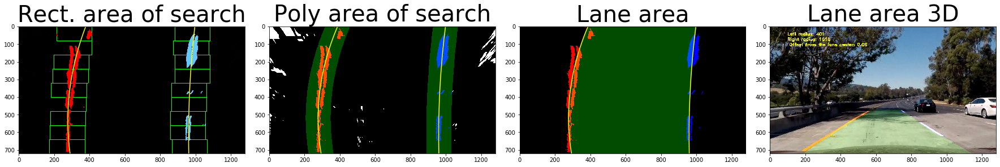

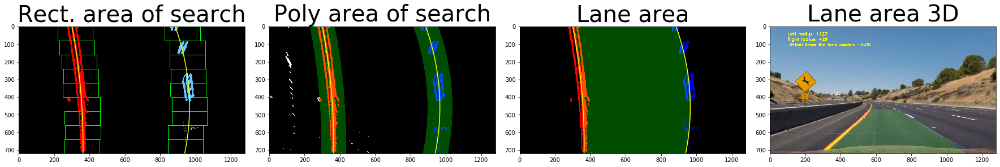

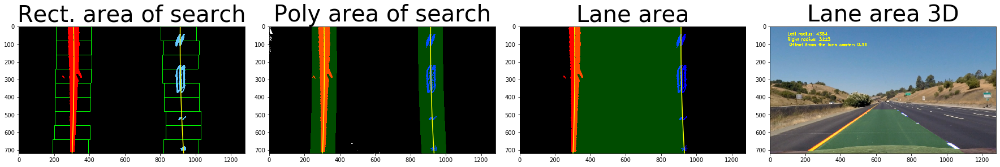

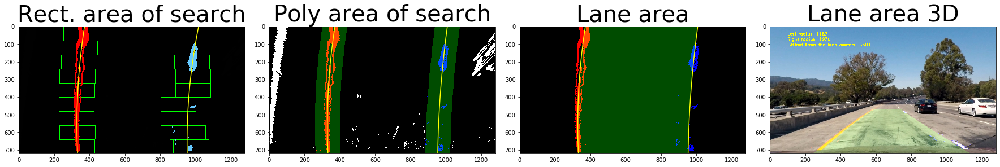

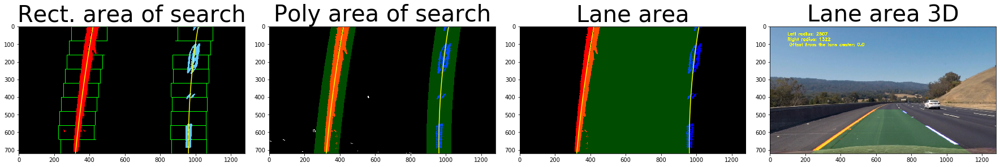

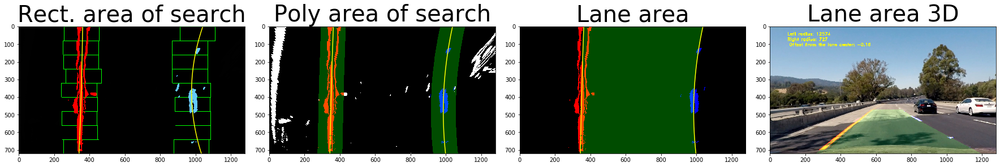

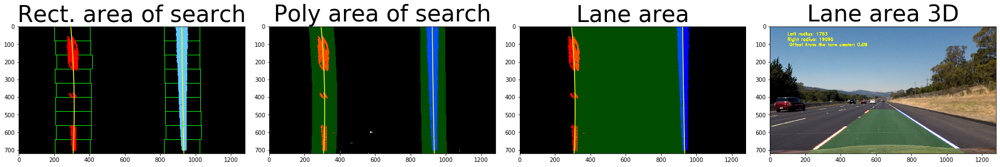

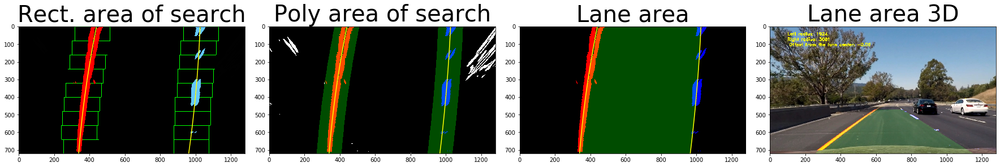

In [36]:
import gc
gc.collect()
src_bottom_left = [200,720]
src_bottom_right = [1200, 720]
src_top_left = [565, 470]
src_top_right = [740, 470]

dst_bottom_left = [300,720]
dst_bottom_right = [1000, 720]
dst_top_left = [300, 1]
dst_top_right = [1000, 1]

src = np.float32([src_bottom_left, src_top_left, src_top_right, src_bottom_right])
dst = np.float32([dst_bottom_left, dst_top_left, dst_top_right, dst_bottom_right])

plt.close('all')
files = glob.glob('test_images/test*.jpg')
i = 0
for file in files:
    img = mpimg.imread(file)
    img = cv2.undistort(img, mtx, dist, None, mtx)

    thresholded = color_grad_thresholding(img, (200, 255), (219, 230), (229, 235), (25, 132))
    # Given src and dst points, calculate the perspective transform matrix
    M = cv2.getPerspectiveTransform(src, dst)
    # Calculate an inverse perspective transformation
    Minv = cv2.getPerspectiveTransform(dst, src)
    # Warp the image using OpenCV warpPerspective()
    warped = cv2.warpPerspective(thresholded, M, (img.shape[1], img.shape[0]))
    left_fitx, right_fitx, left_fit, right_fit, plot_y, rect_search_img = fit_polynomial1(warped)
    lines_area_image, lane_area_image, left_fit_new, right_fit_new, ploty, left_curverad, right_curverad, lane_offset = search_around_poly(warped, left_fit, right_fit)
    lane_offset = truncate(lane_offset, 100)
    unwarped = cv2.warpPerspective(lane_area_image, Minv, (img.shape[1], img.shape[0]))
    colored_lane = cv2.addWeighted(img, 1, unwarped, 0.5, 0)

    # Plot the result
    f, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(rect_search_img)
    ax1.set_title('Rect. area of search', fontsize=40)
    ax1.plot(left_fitx, plot_y, color='yellow')
    ax1.plot(right_fitx, plot_y, color='yellow')
    
    ax2.imshow(lines_area_image, cmap='gray')
    ax2.set_title('Poly area of search', fontsize=40)
    ax2.plot(left_fit_new, ploty, color='yellow')
    ax2.plot(right_fit_new, ploty, color='yellow')
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
   

    ax3.imshow(lane_area_image, cmap='gray')
    ax3.set_title('Lane area', fontsize=40)
    ax3.plot(left_fit_new, ploty, color='yellow')
    ax3.plot(right_fit_new, ploty, color='yellow')
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

    # Visualize the measured curve radius and vehicle position within the lane on the output image
    text1 = 'Left radius: ' + str(math.floor(left_curverad))
    text2 = 'Right radius: ' + str(math.floor(right_curverad))
    text3 = 'Offset from the lane center: ' + str(lane_offset)
    cv2.putText(colored_lane, text1, (100, 50), cv2.FONT_HERSHEY_DUPLEX, 0.8, (255, 255, 0), 2)
    cv2.putText(colored_lane, text2, (100, 80), cv2.FONT_HERSHEY_DUPLEX, 0.8, (255, 255, 0), 2)
    cv2.putText(colored_lane, text3, (110, 110), cv2.FONT_HERSHEY_DUPLEX, 0.8, (255, 255, 0), 2)

    ax4.imshow(colored_lane)
    ax4.set_title('Lane area 3D', fontsize=40)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    # Save the image
    plt.savefig("output_images/"+"test_all"+str(i)+".jpg")
    i+=1

In [32]:
from collections import deque


# Define a class to receive the characteristics of each line detection
class Line():
    def __init__(self):
        # was the line detected in the last iteration?
        self.detected = False
        # Number of measurements being used in the tracking
        self.num_bad_meas = 0
        self.fit_prev0 = None
        self.fit_prev1 = None
        self.fit_prev2 = None
        self.fit_prev_margin = 70
        
        self.fit_curr0 = None
        self.fit_curr1 = None
        self.fit_curr2 = None
        
        self.x_curr = None
        self.y_curr = None
        
        self.poly_x = None
        self.poly_y = None
        
        self.fit0_cum = deque(maxlen=8)   
        self.fit1_cum = deque(maxlen=8)
        self.fit2_cum = deque(maxlen=8)
        
        self.lane_width = deque(maxlen=8)
        
    def prev_search(self, image, side):
        nonzero = image.nonzero()    
        nonzeroy = np.array(nonzero[0])
        nonzerox = np.array(nonzero[1])
        lane_inds = ((nonzerox > (self.fit_prev0*(nonzeroy**2) + self.fit_prev1*nonzeroy + 
                self.fit_prev2 - self.fit_prev_margin)) & (nonzerox < (self.fit_prev0*(nonzeroy**2) + 
                self.fit_prev1*nonzeroy + self.fit_prev2 + self.fit_prev_margin)))
        # extract left and right line pixel positions
        x = nonzerox[lane_inds]
        y = nonzeroy[lane_inds]
        if len(x) != 0:
            fit = np.polyfit(y, x, 2)
            poly_y = np.linspace(0, 719, 720)
            poly_x = fit[0]*poly_y**2 + fit[1]*poly_y + fit[2]
            self.detected = True
        else:
            fit, x, y, poly_x, poly_y = self.random_search(image, side)
        return fit, x, y, poly_x, poly_y

    def random_search(self, image, side):
        # Take a histogram of the bottom half of the image
        histogram = np.sum(image[image.shape[0]//2:,:], axis=0)

        # Find the peak of the left and right halves of the histogram
        # These will be the starting point for the left and right lines
        midpoint = np.int(histogram.shape[0]//2)

        if side == 0: # Left side
            base = np.argmax(histogram[:midpoint])
        else: #Right side
            base = np.argmax(histogram[midpoint:]) + midpoint
        # Choose the number of sliding windows
        nwindows = 9
        # Set minimum number of pixels found to recenter window
        minpix = 70
        margin = 100
        # Set height of windows - based on nwindows above and image shape
        window_height = np.int(image.shape[0]//nwindows)
        # Identify the x and y positions of all nonzero pixels in the image
        nonzero = image.nonzero()
        nonzeroy = np.array(nonzero[0])
        nonzerox = np.array(nonzero[1])
        # Current positions to be updated later for each window in nwindows
        xcurrent = base
        # Create empty lists to receive left and right lane pixel indices
        lane_inds = []
        
        # Step through the windows one by one
        for window in range(nwindows):
            # Identify window boundaries in x and y (and right and left)
            win_y_low = image.shape[0] - (window+1)*window_height
            win_y_high = image.shape[0] - window*window_height
            win_x_low = xcurrent - margin
            win_x_high = xcurrent + margin

            good_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
                (nonzerox >= win_x_low) &  (nonzerox < win_x_high)).nonzero()[0]
        
            # Append these indices to the lists
            lane_inds.append(good_inds)

            if len(good_inds) > minpix:
                x_current = np.int(np.mean(nonzerox[good_inds]))

        # Concatenate the arrays of indices (previously was a list of lists of pixels)
        try:
            lane_inds = np.concatenate(lane_inds)
            lane_inds = np.concatenate(lane_inds)
        except ValueError:
            # Avoids an error if the above is not implemented fully
            pass

        # Extract line pixel positions
        x = nonzerox[lane_inds]
        y = nonzeroy[lane_inds]
        fit = np.polyfit(y, x, 2)
        poly_y = np.linspace(0, 719, 720)
        poly_x = fit[0]*poly_y**2 + fit[1]*poly_y + fit[2]
        self.detected = True
        return fit, x, y, poly_x, poly_y

    def radius_m(self):
        ym_per_pix = 30/720
        xm_per_pix = 3.7/700
        fit_cr = np.polyfit(self.y_curr*ym_per_pix, self.x_curr*xm_per_pix, 2)
        ploty = np.linspace(0, 719, num=720)
        # Choose the reference y-value for the radius calculation. In this case the y-value will represent the bottom of the image
        y_eval = np.max(ploty)*ym_per_pix

        # Calculate R_curve (radius of curvature)
        curverad = ((1 + (2*fit_cr[0]*y_eval + fit_cr[1])**2)**1.5) / np.absolute(2*fit_cr[0])
        return curverad
    
    

In [37]:
src_bottom_left = [200,720]
src_bottom_right = [1200, 720]
src_top_left = [565, 470]
src_top_right = [740, 470]

dst_bottom_left = [300,720]
dst_bottom_right = [1000, 720]
dst_top_left = [300, 1]
dst_top_right = [1000, 1]
src = np.float32([src_bottom_left, src_top_left, src_top_right, src_bottom_right])
dst = np.float32([dst_bottom_left, dst_top_left, dst_top_right, dst_bottom_right])

def calibration():
    nx = 9 # number of inside corners in x
    ny = 6 # number of inside corners in y

    imgpoints = []
    objpoints = []
    objp = np.zeros((6*9,3), np.float32)
    objp[:,:2] = np.mgrid[0:9, 0:6].T.reshape(-1,2)


    #read images
    file = 'camera_cal/calibration2.jpg'
    img = mpimg.imread(file)
    # Convert to grayscale
    grayscale_img = cv2.cvtColor(img,cv2.COLOR_RGB2GRAY)
    # Find corners
    ret, corners = cv2.findChessboardCorners(grayscale_img, (9,6), None)

    if ret == True:
        imgpoints.append(corners)
        objpoints.append(objp)
    #Calibrate the camera
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, grayscale_img.shape[::-1], None, None)
    return mtx, dist

def sanity_check(line_left, line_right, left_curvature_m, right_curvature_m, left_fit0, right_fit0, lane_width):
    print(left_curvature_m < 200)
    print(((np.abs(lane_width) > 4.0)&(np.abs(lane_width) < 2.5)))
    print(np.abs((left_fit0-line_left.fit_curr0))>0.25)
    if left_curvature_m < 200 or ((np.abs(lane_width) > 4.0)&(np.abs(lane_width) < 2.5)) or (np.abs((left_fit0-line_left.fit_curr0))>0.25) or (np.abs(lane_width - np.mean(line_left.lane_width))>0.2):
        line_left.num_bad_meas += 1
        line_left.detected = False
    else:
        if line_left.num_bad_meas > 0:
            line_left.num_bad_meas += -1
        line_left.detected = True
    # Reset the line track if the number of bad frames reached the limit
    if line_left.num_bad_meas >= 5:
        line_left.__init__()

    if right_curvature_m < 200 or ((np.abs(lane_width) > 4.0)&(np.abs(lane_width) < 2.5)) or (np.abs((right_fit0-line_right.fit_curr0))>0.25) or (np.abs(lane_width - np.mean(line_right.lane_width))>0.2):
        line_right.num_bad_meas += 1
        line_right.detected = False
    else:
        if line_right.num_bad_meas > 0:
            line_right.num_bad_meas += -1
            line_right.detected = True
    # Reset the line track if the number of bad frames reached the limit
    if line_right.num_bad_meas >= 5:
        line_right.__init__()

def video_pipeline(image):
    # Define the meter per pixel ratio
    xm_per_pix = 3.7/700
    ym_per_pix = 30/720
    # Calibrate the camera
    mtx, dist = calibration()
    # Undistort the image
    img = cv2.undistort(image, mtx, dist, None, mtx)
    # Perform the color and gradient thresholding
    thresholded = color_grad_thresholding(img, (200, 255), (219, 230), (229, 235), (25, 132))
    # Given src and dst points, calculate the perspective transform matrix
    M = cv2.getPerspectiveTransform(src, dst)
    # Calculate an inverse perspective transformation
    Minv = cv2.getPerspectiveTransform(dst, src)
    colored_warped = cv2.warpPerspective(img, M, (img.shape[1], img.shape[0]))
    # Warp the image using OpenCV warpPerspective()
    warped = cv2.warpPerspective(thresholded, M, (img.shape[1], img.shape[0]))
    #Filter all the high-frequency noise components out
    filtered_img = cv2.medianBlur(warped, 7)
    
    ## Left line
    # Use either the random search if no detection in previous frame was made or use the area around the fitted polynom from the previous frame
    if line_left.detected != True:
        left_fit, leftx, lefty, left_poly_x, left_poly_y = line_left.random_search(filtered_img, 0)
        line_left.detected = True
    else:
        left_fit, leftx, lefty, left_poly_x, left_poly_y = line_left.prev_search(filtered_img, 0)
        line_left.detected = True
    
    line_left.fit_curr0 = left_fit[0]
    line_left.fit_curr1 = left_fit[1]
    line_left.fit_curr2 = left_fit[2]
    line_left.x_curr = leftx
    line_left.y_curr = lefty
    line_left.polynom_x = left_poly_x
    line_left.polynom_y = left_poly_y
    left_radius = line_left.radius_m()

    ## Right line
    if line_right.detected != True:
        right_fit, rightx, righty, right_poly_x, right_poly_y = line_right.random_search(filtered_img, 1)
        line_right.detected = True
    else:
        right_fit, rightx, righty, right_poly_x, right_poly_y = line_right.prev_search(filtered_img, 1)
        line_right.detected = True
    line_right.fit_curr0 = right_fit[0]
    line_right.fit_curr1 = right_fit[1]
    line_right.fit_curr2 = right_fit[2]
    line_right.polynom_x = right_poly_x
    line_right.polynom_y = right_poly_y
    line_right.x_curr = rightx
    line_right.y_curr = righty
    right_radius = line_right.radius_m()
    # Find lane width
    lane_width = (line_right.polynom_x[719] - line_left.polynom_x[719])*xm_per_pix
    # Save the previously calculated lane widths
    
    #Check whether the estimated values lie within the allowed interval
    sanity_check(line_left, line_right, left_radius, right_radius, left_fit[0], right_fit[0], lane_width)
    
    if line_left.detected == True:
        line_left.fit0_cum.append(left_fit[0])
        line_left.fit1_cum.append(left_fit[1])
        line_left.fit2_cum.append(left_fit[2])
        final_left_fit0 = np.mean(line_left.fit0_cum)
        final_left_fit1 = np.mean(line_left.fit1_cum)
        final_left_fit2 = np.mean(line_left.fit2_cum)
        # Recalculate the polynomial
        left_final_x = final_left_fit0*line_left.polynom_y**2 + final_left_fit1*line_left.polynom_y + final_left_fit2
        # Set the current values as the last calculated
        line_left.fit_prev0 = left_fit[0]
        line_left.fit_prev1 = left_fit[1]
        line_left.fit_prev2 = left_fit[2]
        line_left.lane_width.append(lane_width)
    else:
        if line_left.fit_prev0 is not None and line_left.fit_prev1 is not None and line_left.fit_prev2 is not None:
            left_final_x = line_left.fit_prev0*line_left.polynom_y**2 + line_left.fit_prev1*line_left.polynom_y + line_left.fit_prev2
            
    if line_right.detected == True:
        line_right.fit0_cum.append(right_fit[0])
        line_right.fit1_cum.append(right_fit[1])
        line_right.fit2_cum.append(right_fit[2])
        final_right_fit0 = np.mean(line_right.fit0_cum)
        final_right_fit1 = np.mean(line_right.fit1_cum)
        final_right_fit2 = np.mean(line_right.fit2_cum)
        # Recalculate the polynomial
        right_final_x = final_right_fit0*line_right.polynom_y**2 + final_right_fit1*line_right.polynom_y + final_right_fit2
        # Set the current values as the last calculated
        line_right.fit_prev0 = right_fit[0]
        line_right.fit_prev1 = right_fit[1]
        line_right.fit_prev2 = right_fit[2]
        line_right.lane_width.append(lane_width)
    else:
        if line_right.fit_prev0 is not None and line_right.fit_prev1 is not None and line_right.fit_prev2 is not None:
            right_final_x = line_right.fit_prev0*line_right.polynom_y**2 + line_right.fit_prev1*line_right.polynom_y + line_right.fit_prev2
    if line_left.fit_prev0 is not None and line_left.fit_prev1 is not None and line_left.fit_prev2 is not None and line_right.fit_prev0 is not None and line_right.fit_prev1 is not None and line_right.fit_prev2 is not None:
        line_left.x_curr = left_final_x
        line_left.y_curr = line_left.polynom_y
        line_right.x_curr = right_final_x
        line_right.y_curr = line_right.polynom_y
        curverad_left = line_left.radius_m()
        curverad_right = line_right.radius_m()
        
        lane_image = vis(colored_warped, left_final_x, left_poly_y, right_final_x, right_poly_y)
        unwarped = cv2.warpPerspective(lane_image, Minv, (img.shape[1], img.shape[0]))
        result = cv2.addWeighted(img, 1, unwarped, 0.3, 0)
    else:
        result = img
    
    return result
    

def vis(img, leftx, lefty, rightx, righty):
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(img)
    left_line = np.array([np.transpose(np.vstack([leftx, lefty]))])
    right_line = np.array([np.flipud(np.transpose(np.vstack([rightx, righty])))])
    lane_area = np.hstack((left_line, right_line))
    # Draw the lane onto the warped blank image
    cv2.fillPoly(warp_zero, np.int_([lane_area]), (0,255,0))
    return warp_zero
    

In [38]:
# Import everything needed to edit/save/watch video clips
import imageio
from moviepy.editor import VideoFileClip
from IPython.display import HTML
line_left = Line()
line_right = Line()

output = 'output_video/project_video.mp4'
#clip2 = VideoFileClip('test_videos/solidYellowLeft.mp4').subclip(0,5)
#clip1 = VideoFileClip("project_video.mp4").subclip(0,5)
clip1 = VideoFileClip("project_video.mp4")
output_clip = clip1.fl_image(video_pipeline)
%time output_clip.write_videofile(output, audio=False)


False
False
False
[MoviePy] >>>> Building video output_video/project_video.mp4
[MoviePy] Writing video output_video/project_video.mp4




  0%|          | 0/1261 [00:00<?, ?it/s]

  0%|          | 1/1261 [00:00<03:54,  5.38it/s]

  0%|          | 2/1261 [00:00<03:49,  5.47it/s]

False
False
False
False
False
False




  0%|          | 3/1261 [00:00<03:54,  5.37it/s]

False
False
False
False
False
False




  0%|          | 4/1261 [00:00<03:55,  5.33it/s]

  0%|          | 5/1261 [00:00<03:56,  5.30it/s]

  0%|          | 6/1261 [00:01<03:52,  5.39it/s]

False
False
False
False
False
False




  1%|          | 7/1261 [00:01<04:02,  5.18it/s]

False
False
False




  1%|          | 8/1261 [00:01<04:19,  4.82it/s]

False
False
False




  1%|          | 9/1261 [00:01<04:24,  4.73it/s]

False
False
False
False
False
False




  1%|          | 10/1261 [00:01<04:20,  4.80it/s]

  1%|          | 11/1261 [00:02<04:21,  4.78it/s]

False
False
False
False
False
False




  1%|          | 12/1261 [00:02<04:15,  4.89it/s]

  1%|          | 13/1261 [00:02<04:25,  4.70it/s]

False
False
False




  1%|          | 14/1261 [00:02<04:40,  4.45it/s]

False
False
False




  1%|          | 15/1261 [00:03<04:45,  4.36it/s]

False
False
False




  1%|▏         | 16/1261 [00:03<04:38,  4.48it/s]

  1%|▏         | 17/1261 [00:03<04:28,  4.63it/s]

False
False
False
False
False
False
False
False
False




  1%|▏         | 18/1261 [00:03<04:21,  4.75it/s]

  2%|▏         | 19/1261 [00:03<04:29,  4.61it/s]

False
False
False




  2%|▏         | 20/1261 [00:04<04:36,  4.48it/s]

False
False
False




  2%|▏         | 21/1261 [00:04<04:38,  4.45it/s]

False
False
False
False
False
False




  2%|▏         | 22/1261 [00:04<04:27,  4.62it/s]

  2%|▏         | 23/1261 [00:04<04:28,  4.61it/s]

False
False
False




  2%|▏         | 24/1261 [00:05<04:34,  4.51it/s]

False
False
False




  2%|▏         | 25/1261 [00:05<04:30,  4.57it/s]

False
False
False




  2%|▏         | 26/1261 [00:05<04:27,  4.62it/s]

False
False
False




  2%|▏         | 27/1261 [00:05<04:29,  4.58it/s]

False
False
False




  2%|▏         | 28/1261 [00:05<04:22,  4.70it/s]

False
False
False




  2%|▏         | 29/1261 [00:06<04:23,  4.68it/s]

False
False
False




  2%|▏         | 30/1261 [00:06<04:24,  4.65it/s]

False
False
False




  2%|▏         | 31/1261 [00:06<04:25,  4.63it/s]

False
False
False




  3%|▎         | 32/1261 [00:06<04:31,  4.53it/s]

False
False
False




  3%|▎         | 33/1261 [00:07<04:29,  4.56it/s]

  3%|▎         | 34/1261 [00:07<04:12,  4.85it/s]

False
False
False
False
False
False




  3%|▎         | 35/1261 [00:07<04:29,  4.55it/s]

False
False
False




  3%|▎         | 36/1261 [00:07<04:40,  4.37it/s]



False
False
False
False
False
False


  3%|▎         | 37/1261 [00:07<04:24,  4.62it/s]

  3%|▎         | 38/1261 [00:08<04:18,  4.72it/s]

False
False
False




  3%|▎         | 39/1261 [00:08<04:24,  4.62it/s]

False
False
False




  3%|▎         | 40/1261 [00:08<04:23,  4.64it/s]

False
False
False




  3%|▎         | 41/1261 [00:08<04:25,  4.59it/s]

False
False
False




  3%|▎         | 42/1261 [00:08<04:23,  4.63it/s]

False
False
False




  3%|▎         | 43/1261 [00:09<04:40,  4.34it/s]

False
False
False




  3%|▎         | 44/1261 [00:09<04:48,  4.21it/s]

False
False
False




  4%|▎         | 45/1261 [00:09<04:42,  4.30it/s]

False
False
False




  4%|▎         | 46/1261 [00:09<04:37,  4.38it/s]

False
False
False




  4%|▎         | 47/1261 [00:10<04:29,  4.50it/s]

False
False
False




  4%|▍         | 48/1261 [00:10<04:46,  4.23it/s]

False
False
False




  4%|▍         | 49/1261 [00:10<04:40,  4.33it/s]

False
False
False




  4%|▍         | 50/1261 [00:10<04:45,  4.25it/s]

False
False
False




  4%|▍         | 51/1261 [00:11<04:35,  4.39it/s]

False
False
False




  4%|▍         | 52/1261 [00:11<04:43,  4.26it/s]

False
False
False




  4%|▍         | 53/1261 [00:11<04:52,  4.14it/s]

False
False
False




  4%|▍         | 54/1261 [00:11<05:10,  3.89it/s]

False
False
False




  4%|▍         | 55/1261 [00:12<05:26,  3.69it/s]

False
False
False




  4%|▍         | 56/1261 [00:12<05:25,  3.70it/s]

False
False
False




  5%|▍         | 57/1261 [00:12<05:03,  3.97it/s]

False
False
False




  5%|▍         | 58/1261 [00:12<04:47,  4.18it/s]



False
False
False
False
False
False


  5%|▍         | 59/1261 [00:13<04:26,  4.52it/s]

  5%|▍         | 60/1261 [00:13<04:40,  4.29it/s]

False
False
False




  5%|▍         | 61/1261 [00:13<04:36,  4.35it/s]

False
False
False




  5%|▍         | 62/1261 [00:13<04:44,  4.22it/s]

False
False
False




  5%|▍         | 63/1261 [00:14<04:42,  4.24it/s]

False
False
False




  5%|▌         | 64/1261 [00:14<04:40,  4.26it/s]

  5%|▌         | 65/1261 [00:14<04:20,  4.59it/s]

False
False
False
False
False
False




  5%|▌         | 66/1261 [00:14<04:20,  4.59it/s]

False
False
False




  5%|▌         | 67/1261 [00:14<04:36,  4.32it/s]

False
False
False




  5%|▌         | 68/1261 [00:15<04:39,  4.27it/s]

False
False
False




  5%|▌         | 69/1261 [00:15<04:31,  4.39it/s]

  6%|▌         | 70/1261 [00:15<04:15,  4.67it/s]

False
False
False
False
False
False




  6%|▌         | 71/1261 [00:15<04:03,  4.88it/s]

False
False
False




  6%|▌         | 72/1261 [00:15<04:10,  4.74it/s]

False
False
False




  6%|▌         | 73/1261 [00:16<04:09,  4.75it/s]

False
False
False




  6%|▌         | 74/1261 [00:16<04:14,  4.67it/s]

False
False
False
False
False
False




  6%|▌         | 75/1261 [00:16<04:04,  4.85it/s]

  6%|▌         | 76/1261 [00:16<04:13,  4.67it/s]

False
False
False




  6%|▌         | 77/1261 [00:17<04:14,  4.65it/s]

False
False
False
False
False
False




  6%|▌         | 78/1261 [00:17<04:10,  4.73it/s]

  6%|▋         | 79/1261 [00:17<04:00,  4.92it/s]

False
False
False




  6%|▋         | 80/1261 [00:17<04:09,  4.73it/s]

False
False
False




  6%|▋         | 81/1261 [00:17<04:11,  4.68it/s]

False
False
False
False
False
False




  7%|▋         | 82/1261 [00:18<04:04,  4.82it/s]

  7%|▋         | 83/1261 [00:18<04:04,  4.81it/s]

False
False
False




  7%|▋         | 84/1261 [00:18<04:15,  4.61it/s]

False
False
False




  7%|▋         | 85/1261 [00:18<04:29,  4.36it/s]

False
False
False




  7%|▋         | 86/1261 [00:19<04:50,  4.04it/s]

False
False
False




  7%|▋         | 87/1261 [00:19<04:45,  4.12it/s]

False
False
False




  7%|▋         | 88/1261 [00:19<04:44,  4.13it/s]

False
False
False




  7%|▋         | 89/1261 [00:19<04:36,  4.24it/s]

False
False
False




  7%|▋         | 90/1261 [00:19<04:38,  4.21it/s]

False
False
False




  7%|▋         | 91/1261 [00:20<04:27,  4.37it/s]

False
False
False




  7%|▋         | 92/1261 [00:20<04:35,  4.24it/s]

False
False
False




  7%|▋         | 93/1261 [00:20<04:28,  4.35it/s]

False
False
False




  7%|▋         | 94/1261 [00:20<04:19,  4.50it/s]

False
False
False




  8%|▊         | 95/1261 [00:21<04:19,  4.49it/s]

False
False
False




  8%|▊         | 96/1261 [00:21<04:25,  4.38it/s]

False
False
False




  8%|▊         | 97/1261 [00:21<04:27,  4.35it/s]

False
False
False




  8%|▊         | 98/1261 [00:21<04:33,  4.24it/s]

False
False
False




  8%|▊         | 99/1261 [00:22<04:30,  4.29it/s]

False
False
False




  8%|▊         | 100/1261 [00:22<04:33,  4.24it/s]

False
False
False
False
False
False




  8%|▊         | 101/1261 [00:22<04:19,  4.46it/s]

  8%|▊         | 102/1261 [00:22<04:07,  4.68it/s]

False
False
False




  8%|▊         | 103/1261 [00:22<04:07,  4.69it/s]

False
False
False




  8%|▊         | 104/1261 [00:23<04:06,  4.70it/s]

False
False
False




  8%|▊         | 105/1261 [00:23<04:08,  4.65it/s]

  8%|▊         | 106/1261 [00:23<03:58,  4.85it/s]

False
False
False
False
False
False




  8%|▊         | 107/1261 [00:23<03:57,  4.86it/s]

False
False
False




  9%|▊         | 108/1261 [00:23<03:57,  4.86it/s]

False
False
False




  9%|▊         | 109/1261 [00:24<03:58,  4.82it/s]

False
False
False
False
False
False




  9%|▊         | 110/1261 [00:24<03:54,  4.92it/s]

  9%|▉         | 111/1261 [00:24<03:50,  4.99it/s]

False
False
False




  9%|▉         | 112/1261 [00:24<03:59,  4.79it/s]

False
False
False




  9%|▉         | 113/1261 [00:24<04:00,  4.78it/s]

False
False
False




  9%|▉         | 114/1261 [00:25<03:58,  4.81it/s]

False
False
False
False
False
False




  9%|▉         | 115/1261 [00:25<03:55,  4.86it/s]

  9%|▉         | 116/1261 [00:25<04:07,  4.63it/s]

  9%|▉         | 117/1261 [00:25<03:51,  4.95it/s]

False
False
False
False
False
False




  9%|▉         | 118/1261 [00:25<03:50,  4.95it/s]

False
False
False
False
False
False




  9%|▉         | 119/1261 [00:26<03:50,  4.95it/s]

 10%|▉         | 120/1261 [00:26<04:02,  4.70it/s]

False
False
False
False
False
False




 10%|▉         | 121/1261 [00:26<04:00,  4.75it/s]

 10%|▉         | 122/1261 [00:26<03:58,  4.77it/s]

False
False
False




 10%|▉         | 123/1261 [00:27<04:14,  4.48it/s]

False
False
False




 10%|▉         | 124/1261 [00:27<04:14,  4.46it/s]

False
False
False
False
False
False




 10%|▉         | 125/1261 [00:27<04:06,  4.60it/s]

 10%|▉         | 126/1261 [00:27<04:01,  4.70it/s]

False
False
False
False
False
False




 10%|█         | 127/1261 [00:27<03:58,  4.76it/s]

 10%|█         | 128/1261 [00:28<03:54,  4.84it/s]

False
False
False




 10%|█         | 129/1261 [00:28<03:53,  4.84it/s]



False
False
False
False
False
False


 10%|█         | 130/1261 [00:28<03:45,  5.01it/s]

 10%|█         | 131/1261 [00:28<03:46,  4.98it/s]

False
False
False




 10%|█         | 132/1261 [00:28<04:01,  4.67it/s]

False
False
False
False
False
False




 11%|█         | 133/1261 [00:29<03:56,  4.77it/s]

 11%|█         | 134/1261 [00:29<03:47,  4.95it/s]

False
False
False
False
False
False




 11%|█         | 135/1261 [00:29<03:47,  4.95it/s]

 11%|█         | 136/1261 [00:29<03:59,  4.70it/s]

False
False
False




 11%|█         | 137/1261 [00:29<04:03,  4.61it/s]

False
False
False




 11%|█         | 138/1261 [00:30<04:04,  4.59it/s]

False
False
False




 11%|█         | 139/1261 [00:30<04:04,  4.58it/s]

False
False
False




 11%|█         | 140/1261 [00:30<04:05,  4.56it/s]

False
False
False




 11%|█         | 141/1261 [00:30<04:01,  4.63it/s]

 11%|█▏        | 142/1261 [00:31<03:56,  4.73it/s]

False
False
False
False
False
False
False
False
False




 11%|█▏        | 143/1261 [00:31<03:52,  4.82it/s]

 11%|█▏        | 144/1261 [00:31<03:56,  4.73it/s]

False
False
False




 11%|█▏        | 145/1261 [00:31<03:58,  4.68it/s]

False
False
False




 12%|█▏        | 146/1261 [00:31<03:58,  4.67it/s]

False
False
False




 12%|█▏        | 147/1261 [00:32<03:53,  4.77it/s]

 12%|█▏        | 148/1261 [00:32<03:50,  4.83it/s]

False
False
False
False
False
False
False
False
False




 12%|█▏        | 149/1261 [00:32<03:48,  4.88it/s]

 12%|█▏        | 150/1261 [00:32<03:46,  4.91it/s]

False
False
False




 12%|█▏        | 151/1261 [00:32<03:49,  4.84it/s]

False
False
False




 12%|█▏        | 152/1261 [00:33<03:54,  4.72it/s]

False
False
False




 12%|█▏        | 153/1261 [00:33<03:55,  4.70it/s]

False
False
False




 12%|█▏        | 154/1261 [00:33<04:00,  4.60it/s]

False
False
False
False
False
False




 12%|█▏        | 155/1261 [00:33<03:49,  4.81it/s]

 12%|█▏        | 156/1261 [00:33<03:51,  4.76it/s]

 12%|█▏        | 157/1261 [00:34<03:39,  5.03it/s]

False
False
False
False
False
False




 13%|█▎        | 158/1261 [00:34<03:35,  5.12it/s]



False
False
False
False
False
False


 13%|█▎        | 159/1261 [00:34<03:30,  5.25it/s]

 13%|█▎        | 160/1261 [00:34<03:38,  5.05it/s]

False
False
False
False
False
False




 13%|█▎        | 161/1261 [00:34<03:40,  5.00it/s]

 13%|█▎        | 162/1261 [00:35<03:44,  4.89it/s]

 13%|█▎        | 163/1261 [00:35<03:36,  5.08it/s]

False
False
False
False
False
False




 13%|█▎        | 164/1261 [00:35<03:45,  4.86it/s]



False
False
False
False
False
False


 13%|█▎        | 165/1261 [00:35<03:37,  5.04it/s]

 13%|█▎        | 166/1261 [00:35<03:37,  5.03it/s]

 13%|█▎        | 167/1261 [00:36<03:31,  5.18it/s]

False
False
False
False
False
False




 13%|█▎        | 168/1261 [00:36<03:32,  5.15it/s]

False
False
False




 13%|█▎        | 169/1261 [00:36<03:44,  4.86it/s]

False
False
False




 13%|█▎        | 170/1261 [00:36<03:45,  4.85it/s]

False
False
False
False




 14%|█▎        | 171/1261 [00:36<03:43,  4.87it/s]

False
False




 14%|█▎        | 172/1261 [00:37<03:52,  4.69it/s]



False
False
False
False
False
False


 14%|█▎        | 173/1261 [00:37<03:43,  4.87it/s]

 14%|█▍        | 174/1261 [00:37<03:43,  4.86it/s]

 14%|█▍        | 175/1261 [00:37<03:36,  5.02it/s]

False
False
False
False
False
False




 14%|█▍        | 176/1261 [00:38<03:46,  4.79it/s]

False
False
False
False
False
False




 14%|█▍        | 177/1261 [00:38<03:42,  4.87it/s]

 14%|█▍        | 178/1261 [00:38<03:45,  4.81it/s]

False
False
False




 14%|█▍        | 179/1261 [00:38<03:46,  4.78it/s]

False
False
False




 14%|█▍        | 180/1261 [00:38<03:50,  4.68it/s]

False
False
False




 14%|█▍        | 181/1261 [00:39<03:51,  4.67it/s]

False
False
False




 14%|█▍        | 182/1261 [00:39<03:53,  4.63it/s]

 15%|█▍        | 183/1261 [00:39<03:41,  4.87it/s]

False
False
False
False
False
False




 15%|█▍        | 184/1261 [00:39<03:46,  4.76it/s]

 15%|█▍        | 185/1261 [00:39<03:32,  5.06it/s]

False
False
False
False
False
False




 15%|█▍        | 186/1261 [00:40<03:28,  5.16it/s]

 15%|█▍        | 187/1261 [00:40<03:23,  5.27it/s]

False
False
False
False
False
False




 15%|█▍        | 188/1261 [00:40<03:31,  5.08it/s]

False
False
False




 15%|█▍        | 189/1261 [00:40<03:37,  4.94it/s]

False
False
False




 15%|█▌        | 190/1261 [00:40<03:35,  4.98it/s]

False
False
False
False
False
False




 15%|█▌        | 191/1261 [00:41<03:35,  4.98it/s]

 15%|█▌        | 192/1261 [00:41<03:37,  4.92it/s]

False
False
False




 15%|█▌        | 193/1261 [00:41<03:45,  4.74it/s]

False
False
False
False
False
False




 15%|█▌        | 194/1261 [00:41<03:39,  4.87it/s]

 15%|█▌        | 195/1261 [00:41<03:51,  4.60it/s]

False
False
False




 16%|█▌        | 196/1261 [00:42<04:03,  4.38it/s]

False
False
False




 16%|█▌        | 197/1261 [00:42<04:24,  4.02it/s]

 16%|█▌        | 198/1261 [00:42<04:02,  4.39it/s]

False
False
False
False
False
False




 16%|█▌        | 199/1261 [00:42<03:43,  4.75it/s]



False
False
False
False
False
False


 16%|█▌        | 200/1261 [00:43<03:35,  4.91it/s]

 16%|█▌        | 201/1261 [00:43<03:34,  4.95it/s]

False
False
False
False
False
False




 16%|█▌        | 202/1261 [00:43<03:30,  5.03it/s]

 16%|█▌        | 203/1261 [00:43<03:27,  5.10it/s]

False
False
False




 16%|█▌        | 204/1261 [00:43<03:37,  4.87it/s]

False
False
False




 16%|█▋        | 205/1261 [00:44<03:39,  4.81it/s]

 16%|█▋        | 206/1261 [00:44<03:28,  5.06it/s]

False
False
False
False
False
False




 16%|█▋        | 207/1261 [00:44<03:23,  5.19it/s]

False
False
False
False
False
False




 16%|█▋        | 208/1261 [00:44<03:23,  5.17it/s]

 17%|█▋        | 209/1261 [00:44<03:27,  5.08it/s]

False
False
False
False
False
False




 17%|█▋        | 210/1261 [00:44<03:27,  5.06it/s]

 17%|█▋        | 211/1261 [00:45<03:30,  4.98it/s]

False
False
False




 17%|█▋        | 212/1261 [00:45<03:35,  4.86it/s]

False
False
False




 17%|█▋        | 213/1261 [00:45<03:36,  4.83it/s]

False
False
False




 17%|█▋        | 214/1261 [00:45<03:36,  4.83it/s]

False
False
False
False
False
False




 17%|█▋        | 215/1261 [00:46<03:32,  4.93it/s]

 17%|█▋        | 216/1261 [00:46<03:43,  4.68it/s]

 17%|█▋        | 217/1261 [00:46<03:30,  4.97it/s]

False
False
False
False
False
False




 17%|█▋        | 218/1261 [00:46<03:25,  5.07it/s]

 17%|█▋        | 219/1261 [00:46<03:20,  5.21it/s]

False
False
False
False
False
False




 17%|█▋        | 220/1261 [00:47<03:28,  4.99it/s]

False
False
False




 18%|█▊        | 221/1261 [00:47<03:37,  4.77it/s]

 18%|█▊        | 222/1261 [00:47<03:30,  4.95it/s]

False
False
False
False
False
False




 18%|█▊        | 223/1261 [00:47<03:22,  5.14it/s]

False
False
False




 18%|█▊        | 224/1261 [00:47<03:27,  4.99it/s]

False
False
False




 18%|█▊        | 225/1261 [00:48<03:28,  4.98it/s]

False
False
False
False
False
False




 18%|█▊        | 226/1261 [00:48<03:26,  5.01it/s]

 18%|█▊        | 227/1261 [00:48<03:23,  5.07it/s]

False
False
False




 18%|█▊        | 228/1261 [00:48<03:31,  4.88it/s]

False
False
False
False
False
False




 18%|█▊        | 229/1261 [00:48<03:29,  4.92it/s]

 18%|█▊        | 230/1261 [00:49<03:25,  5.02it/s]

False
False
False
False
False
False




 18%|█▊        | 231/1261 [00:49<03:22,  5.07it/s]

 18%|█▊        | 232/1261 [00:49<03:24,  5.03it/s]

False
False
False
False
False
False




 18%|█▊        | 233/1261 [00:49<03:23,  5.05it/s]

 19%|█▊        | 234/1261 [00:49<03:21,  5.10it/s]

False
False
False




 19%|█▊        | 235/1261 [00:50<03:28,  4.93it/s]

False
False
False




 19%|█▊        | 236/1261 [00:50<03:25,  4.99it/s]

False
False
False




 19%|█▉        | 237/1261 [00:50<03:29,  4.88it/s]

False
False
False
False
False
False




 19%|█▉        | 238/1261 [00:50<03:26,  4.97it/s]

 19%|█▉        | 239/1261 [00:50<03:20,  5.09it/s]

False
False
False




 19%|█▉        | 240/1261 [00:51<03:25,  4.98it/s]

False
False
False




 19%|█▉        | 241/1261 [00:51<03:24,  4.99it/s]



False
False
False
False
False
False


 19%|█▉        | 242/1261 [00:51<03:20,  5.08it/s]

 19%|█▉        | 243/1261 [00:51<03:19,  5.11it/s]



False
False
False
False
False
False


 19%|█▉        | 244/1261 [00:51<03:16,  5.17it/s]

 19%|█▉        | 245/1261 [00:52<03:17,  5.13it/s]

 20%|█▉        | 246/1261 [00:52<03:14,  5.21it/s]

False
False
False
False
False
False




 20%|█▉        | 247/1261 [00:52<03:14,  5.22it/s]

False
False
False




 20%|█▉        | 248/1261 [00:52<03:22,  5.00it/s]

False
False
False




 20%|█▉        | 249/1261 [00:52<03:23,  4.99it/s]

False
False
False




 20%|█▉        | 250/1261 [00:53<03:30,  4.80it/s]

False
False
False




 20%|█▉        | 251/1261 [00:53<03:38,  4.61it/s]

False
False
False




 20%|█▉        | 252/1261 [00:53<03:43,  4.52it/s]

False
False
False




 20%|██        | 253/1261 [00:53<03:42,  4.52it/s]

False
False
False




 20%|██        | 254/1261 [00:53<03:43,  4.50it/s]

False
False
False




 20%|██        | 255/1261 [00:54<03:40,  4.57it/s]

False
False
False




 20%|██        | 256/1261 [00:54<03:43,  4.49it/s]

False
False
False
False
False
False




 20%|██        | 257/1261 [00:54<03:33,  4.70it/s]

 20%|██        | 258/1261 [00:54<03:35,  4.64it/s]

False
False
False




 21%|██        | 259/1261 [00:55<03:36,  4.63it/s]

False
False
False




 21%|██        | 260/1261 [00:55<03:39,  4.56it/s]

False
False
False
False
False
False




 21%|██        | 261/1261 [00:55<03:36,  4.63it/s]

 21%|██        | 262/1261 [00:55<03:32,  4.70it/s]

 21%|██        | 263/1261 [00:55<03:23,  4.90it/s]

False
False
False
False
False
False




 21%|██        | 264/1261 [00:56<03:21,  4.94it/s]

False
False
False




 21%|██        | 265/1261 [00:56<03:25,  4.85it/s]

False
False
False




 21%|██        | 266/1261 [00:56<03:27,  4.80it/s]

False
False
False




 21%|██        | 267/1261 [00:56<03:26,  4.81it/s]

False
False
False




 21%|██▏       | 268/1261 [00:56<03:30,  4.73it/s]

False
False
False
False
False
False




 21%|██▏       | 269/1261 [00:57<03:24,  4.85it/s]

 21%|██▏       | 270/1261 [00:57<03:17,  5.01it/s]

 21%|██▏       | 271/1261 [00:57<03:13,  5.13it/s]

False
False
False
False
False
False




 22%|██▏       | 272/1261 [00:57<03:17,  5.01it/s]

False
False
False




 22%|██▏       | 273/1261 [00:57<03:23,  4.86it/s]

 22%|██▏       | 274/1261 [00:58<03:15,  5.04it/s]

False
False
False
False
False
False




 22%|██▏       | 275/1261 [00:58<03:11,  5.16it/s]

False
False
False




 22%|██▏       | 276/1261 [00:58<03:22,  4.87it/s]

False
False
False




 22%|██▏       | 277/1261 [00:58<03:21,  4.87it/s]

False
False
False




 22%|██▏       | 278/1261 [00:58<03:24,  4.81it/s]

False
False
False




 22%|██▏       | 279/1261 [00:59<03:22,  4.85it/s]

False
False
False




 22%|██▏       | 280/1261 [00:59<03:28,  4.71it/s]

False
False
False
False
False
False




 22%|██▏       | 281/1261 [00:59<03:24,  4.80it/s]

 22%|██▏       | 282/1261 [00:59<03:13,  5.07it/s]

 22%|██▏       | 283/1261 [00:59<03:09,  5.17it/s]

False
False
False
False
False
False




 23%|██▎       | 284/1261 [01:00<03:11,  5.09it/s]

False
False
False




 23%|██▎       | 285/1261 [01:00<03:15,  5.00it/s]

False
False
False
False
False
False




 23%|██▎       | 286/1261 [01:00<03:14,  5.02it/s]

 23%|██▎       | 287/1261 [01:00<03:11,  5.08it/s]

False
False
False




 23%|██▎       | 288/1261 [01:00<03:20,  4.86it/s]

False
False
False
False
False
False




 23%|██▎       | 289/1261 [01:01<03:17,  4.92it/s]

 23%|██▎       | 290/1261 [01:01<03:12,  5.05it/s]

False
False
False
False
False
False




 23%|██▎       | 291/1261 [01:01<03:14,  4.99it/s]

 23%|██▎       | 292/1261 [01:01<03:19,  4.86it/s]

False
False
False
False




 23%|██▎       | 293/1261 [01:01<03:18,  4.89it/s]

False
False




 23%|██▎       | 294/1261 [01:02<03:22,  4.78it/s]

False
False
False
False
False
False




 23%|██▎       | 295/1261 [01:02<03:15,  4.93it/s]

 23%|██▎       | 296/1261 [01:02<03:18,  4.86it/s]

 24%|██▎       | 297/1261 [01:02<03:09,  5.10it/s]

False
False
False
False
False
False




 24%|██▎       | 298/1261 [01:02<03:12,  5.01it/s]

False
False
False




 24%|██▎       | 299/1261 [01:03<03:16,  4.90it/s]

False
False
False
False




 24%|██▍       | 300/1261 [01:03<03:14,  4.94it/s]

False
False
False
False
False




 24%|██▍       | 301/1261 [01:03<03:14,  4.94it/s]

 24%|██▍       | 302/1261 [01:03<03:18,  4.83it/s]



False
False
False
False
False
False


 24%|██▍       | 303/1261 [01:03<03:12,  4.97it/s]

 24%|██▍       | 304/1261 [01:04<03:07,  5.10it/s]

False
False
False
False
False
False




 24%|██▍       | 305/1261 [01:04<03:09,  5.06it/s]

 24%|██▍       | 306/1261 [01:04<03:23,  4.69it/s]

False
False
False




 24%|██▍       | 307/1261 [01:04<03:20,  4.76it/s]

False
False
False
False
False
False




 24%|██▍       | 308/1261 [01:04<03:15,  4.87it/s]

 25%|██▍       | 309/1261 [01:05<03:14,  4.90it/s]

False
False
False




 25%|██▍       | 310/1261 [01:05<03:22,  4.70it/s]

False
False
False




 25%|██▍       | 311/1261 [01:05<03:24,  4.65it/s]

False
False
False




 25%|██▍       | 312/1261 [01:05<03:27,  4.58it/s]



False
False
False
False
False
False


 25%|██▍       | 313/1261 [01:06<03:17,  4.79it/s]

 25%|██▍       | 314/1261 [01:06<03:27,  4.57it/s]

False
False
False




 25%|██▍       | 315/1261 [01:06<03:25,  4.59it/s]

 25%|██▌       | 316/1261 [01:06<03:15,  4.83it/s]

False
False
False
False
False
False




 25%|██▌       | 317/1261 [01:06<03:08,  5.01it/s]

False
False
False




 25%|██▌       | 318/1261 [01:07<03:12,  4.90it/s]

 25%|██▌       | 319/1261 [01:07<03:06,  5.05it/s]

False
False
False
False
False
False




 25%|██▌       | 320/1261 [01:07<03:00,  5.20it/s]

 25%|██▌       | 321/1261 [01:07<02:57,  5.29it/s]

False
False
False
False
False
False




 26%|██▌       | 322/1261 [01:07<03:03,  5.11it/s]

False
False
False




 26%|██▌       | 323/1261 [01:08<03:08,  4.97it/s]

False
False
False
False
False
False




 26%|██▌       | 324/1261 [01:08<03:04,  5.09it/s]

 26%|██▌       | 325/1261 [01:08<03:05,  5.05it/s]

False
False
False




 26%|██▌       | 326/1261 [01:08<03:07,  4.98it/s]

False
False
False
False
False
False




 26%|██▌       | 327/1261 [01:08<03:10,  4.91it/s]

 26%|██▌       | 328/1261 [01:09<03:12,  4.85it/s]

False
False
False
False
False
False




 26%|██▌       | 329/1261 [01:09<03:08,  4.95it/s]

 26%|██▌       | 330/1261 [01:09<03:10,  4.89it/s]

False
False
False
False
False
False




 26%|██▌       | 331/1261 [01:09<03:09,  4.90it/s]

 26%|██▋       | 332/1261 [01:09<03:07,  4.96it/s]

False
False
False
False




 26%|██▋       | 333/1261 [01:10<03:07,  4.94it/s]

False
False




 26%|██▋       | 334/1261 [01:10<03:12,  4.81it/s]

False
False
False




 27%|██▋       | 335/1261 [01:10<03:12,  4.82it/s]

False
False
False
False
False
False




 27%|██▋       | 336/1261 [01:10<03:08,  4.90it/s]

 27%|██▋       | 337/1261 [01:10<03:06,  4.95it/s]

False
False
False




 27%|██▋       | 338/1261 [01:11<03:10,  4.85it/s]

 27%|██▋       | 339/1261 [01:11<03:00,  5.10it/s]

False
False
False
False
False
False




 27%|██▋       | 340/1261 [01:11<02:58,  5.15it/s]

 27%|██▋       | 341/1261 [01:11<02:56,  5.22it/s]

False
False
False
False
False
False




 27%|██▋       | 342/1261 [01:11<03:09,  4.86it/s]

False
False
False




 27%|██▋       | 343/1261 [01:12<03:10,  4.82it/s]

False
False
False
False
False
False




 27%|██▋       | 344/1261 [01:12<03:05,  4.93it/s]

 27%|██▋       | 345/1261 [01:12<03:02,  5.02it/s]

False
False
False




 27%|██▋       | 346/1261 [01:12<03:12,  4.75it/s]

False
False
False
False
False
False




 28%|██▊       | 347/1261 [01:12<03:08,  4.84it/s]

 28%|██▊       | 348/1261 [01:13<03:00,  5.06it/s]

False
False
False
False




 28%|██▊       | 349/1261 [01:13<03:06,  4.90it/s]

False
False




 28%|██▊       | 350/1261 [01:13<03:07,  4.86it/s]

False
False
False
False
False
False




 28%|██▊       | 351/1261 [01:13<03:04,  4.93it/s]

 28%|██▊       | 352/1261 [01:13<03:02,  4.99it/s]

False
False
False




 28%|██▊       | 353/1261 [01:14<03:05,  4.89it/s]

False
False
False




 28%|██▊       | 354/1261 [01:14<03:10,  4.77it/s]

False
False
False




 28%|██▊       | 355/1261 [01:14<03:11,  4.73it/s]



False
False
False
False
False
False


 28%|██▊       | 356/1261 [01:14<03:04,  4.90it/s]

 28%|██▊       | 357/1261 [01:14<03:04,  4.91it/s]

False
False
False




 28%|██▊       | 358/1261 [01:15<03:10,  4.74it/s]

False
False
False
False




 28%|██▊       | 359/1261 [01:15<03:06,  4.84it/s]

False
False




 29%|██▊       | 360/1261 [01:15<03:08,  4.79it/s]

False
False
False




 29%|██▊       | 361/1261 [01:15<03:05,  4.86it/s]

False
False
False




 29%|██▊       | 362/1261 [01:16<03:11,  4.70it/s]

False
False
False
False
False
False




 29%|██▉       | 363/1261 [01:16<03:07,  4.79it/s]

 29%|██▉       | 364/1261 [01:16<03:02,  4.91it/s]

False
False
False
False
False
False




 29%|██▉       | 365/1261 [01:16<03:00,  4.96it/s]

 29%|██▉       | 366/1261 [01:16<03:01,  4.93it/s]

False
False
False




 29%|██▉       | 367/1261 [01:17<03:11,  4.67it/s]

False
False
False
False
False
False




 29%|██▉       | 368/1261 [01:17<03:05,  4.81it/s]

 29%|██▉       | 369/1261 [01:17<03:03,  4.86it/s]

False
False
False




 29%|██▉       | 370/1261 [01:17<03:04,  4.84it/s]

False
False
False




 29%|██▉       | 371/1261 [01:17<03:08,  4.73it/s]

False
False
False
False
False
False




 30%|██▉       | 372/1261 [01:18<03:03,  4.86it/s]

 30%|██▉       | 373/1261 [01:18<03:00,  4.92it/s]

False
False
False




 30%|██▉       | 374/1261 [01:18<03:08,  4.71it/s]

False
False
False
False
False
False




 30%|██▉       | 375/1261 [01:18<03:02,  4.87it/s]

 30%|██▉       | 376/1261 [01:18<02:59,  4.92it/s]

False
False
False
False
False
False




 30%|██▉       | 377/1261 [01:19<02:56,  5.01it/s]

 30%|██▉       | 378/1261 [01:19<02:58,  4.96it/s]

False
False
False




 30%|███       | 379/1261 [01:19<03:01,  4.85it/s]

False
False
False




 30%|███       | 380/1261 [01:19<03:02,  4.83it/s]

False
False
False




 30%|███       | 381/1261 [01:19<03:00,  4.86it/s]

False
False
False




 30%|███       | 382/1261 [01:20<03:06,  4.71it/s]

 30%|███       | 383/1261 [01:20<02:57,  4.96it/s]

False
False
False
False
False
False




 30%|███       | 384/1261 [01:20<02:52,  5.08it/s]

 31%|███       | 385/1261 [01:20<02:49,  5.18it/s]

False
False
False
False
False
False




 31%|███       | 386/1261 [01:20<02:57,  4.92it/s]

False
False
False
False
False
False




 31%|███       | 387/1261 [01:21<02:58,  4.90it/s]

 31%|███       | 388/1261 [01:21<02:49,  5.14it/s]

 31%|███       | 389/1261 [01:21<02:42,  5.36it/s]

False
False
False
False
False
False




 31%|███       | 390/1261 [01:21<02:47,  5.19it/s]

False
False
False
False




 31%|███       | 391/1261 [01:21<02:49,  5.13it/s]

False
False
False
False
False




 31%|███       | 392/1261 [01:22<02:49,  5.12it/s]

 31%|███       | 393/1261 [01:22<02:49,  5.12it/s]

False
False
False




 31%|███       | 394/1261 [01:22<02:53,  4.98it/s]

False
False
False
False
False
False




 31%|███▏      | 395/1261 [01:22<02:53,  4.98it/s]

 31%|███▏      | 396/1261 [01:22<02:52,  5.01it/s]

 31%|███▏      | 397/1261 [01:23<02:48,  5.13it/s]

False
False
False
False
False
False




 32%|███▏      | 398/1261 [01:23<02:48,  5.13it/s]

False
False
False




 32%|███▏      | 399/1261 [01:23<02:52,  5.00it/s]

False
False
False
False
False
False




 32%|███▏      | 400/1261 [01:23<02:49,  5.09it/s]

 32%|███▏      | 401/1261 [01:23<02:47,  5.12it/s]

False
False
False




 32%|███▏      | 402/1261 [01:24<03:01,  4.74it/s]

False
False
False
False
False
False




 32%|███▏      | 403/1261 [01:24<02:56,  4.87it/s]

 32%|███▏      | 404/1261 [01:24<02:50,  5.04it/s]

 32%|███▏      | 405/1261 [01:24<02:44,  5.19it/s]

False
False
False
False
False
False




 32%|███▏      | 406/1261 [01:24<02:58,  4.79it/s]

False
False
False
False
False
False




 32%|███▏      | 407/1261 [01:25<02:56,  4.84it/s]

 32%|███▏      | 408/1261 [01:25<02:52,  4.96it/s]

False
False
False
False
False
False




 32%|███▏      | 409/1261 [01:25<02:50,  5.00it/s]

 33%|███▎      | 410/1261 [01:25<03:01,  4.69it/s]

False
False
False




 33%|███▎      | 411/1261 [01:25<03:02,  4.65it/s]

False
False
False
False
False
False




 33%|███▎      | 412/1261 [01:26<02:57,  4.78it/s]

 33%|███▎      | 413/1261 [01:26<02:55,  4.85it/s]

False
False
False




 33%|███▎      | 414/1261 [01:26<02:54,  4.84it/s]

False
False
False




 33%|███▎      | 415/1261 [01:26<02:55,  4.82it/s]

False
False
False
False
False
False




 33%|███▎      | 416/1261 [01:26<02:53,  4.88it/s]

 33%|███▎      | 417/1261 [01:27<02:50,  4.96it/s]

False
False
False




 33%|███▎      | 418/1261 [01:27<02:56,  4.77it/s]

False
False
False
False
False
False




 33%|███▎      | 419/1261 [01:27<02:56,  4.78it/s]

 33%|███▎      | 420/1261 [01:27<02:58,  4.72it/s]

 33%|███▎      | 421/1261 [01:27<02:48,  4.98it/s]

False
False
False
False
False
False




 33%|███▎      | 422/1261 [01:28<02:49,  4.96it/s]

False
False
False
False
False
False




 34%|███▎      | 423/1261 [01:28<02:48,  4.97it/s]

 34%|███▎      | 424/1261 [01:28<02:51,  4.89it/s]

False
False
False




 34%|███▎      | 425/1261 [01:28<02:53,  4.82it/s]

False
False
False
False
False
False




 34%|███▍      | 426/1261 [01:29<02:54,  4.78it/s]

 34%|███▍      | 427/1261 [01:29<02:57,  4.70it/s]

False
False
False




 34%|███▍      | 428/1261 [01:29<02:56,  4.71it/s]

False
False
False




 34%|███▍      | 429/1261 [01:29<02:54,  4.77it/s]

False
False
False




 34%|███▍      | 430/1261 [01:29<02:54,  4.76it/s]

False
False
False
False
False
False




 34%|███▍      | 431/1261 [01:30<02:50,  4.86it/s]

 34%|███▍      | 432/1261 [01:30<02:47,  4.95it/s]

 34%|███▍      | 433/1261 [01:30<02:43,  5.05it/s]

False
False
False
False
False
False




 34%|███▍      | 434/1261 [01:30<02:54,  4.74it/s]

 34%|███▍      | 435/1261 [01:30<02:45,  4.98it/s]

False
False
False
False
False
False




 35%|███▍      | 436/1261 [01:31<02:42,  5.08it/s]

False
False
False




 35%|███▍      | 437/1261 [01:31<02:44,  5.00it/s]

False
False
False




 35%|███▍      | 438/1261 [01:31<02:51,  4.79it/s]

False
False
False




 35%|███▍      | 439/1261 [01:31<02:52,  4.76it/s]



False
False
False
False
False
False


 35%|███▍      | 440/1261 [01:31<02:46,  4.94it/s]

 35%|███▍      | 441/1261 [01:32<02:48,  4.88it/s]

False
False
False




 35%|███▌      | 442/1261 [01:32<02:51,  4.78it/s]

False
False
False




 35%|███▌      | 443/1261 [01:32<02:53,  4.72it/s]

False
False
False




 35%|███▌      | 444/1261 [01:32<02:51,  4.77it/s]

False
False
False




 35%|███▌      | 445/1261 [01:32<02:53,  4.69it/s]

False
False
False
False
False
False




 35%|███▌      | 446/1261 [01:33<02:50,  4.77it/s]

 35%|███▌      | 447/1261 [01:33<02:49,  4.81it/s]

False
False
False
False
False
False




 36%|███▌      | 448/1261 [01:33<02:46,  4.89it/s]

 36%|███▌      | 449/1261 [01:33<02:46,  4.88it/s]

False
False
False




 36%|███▌      | 450/1261 [01:33<02:45,  4.89it/s]

False
False
False




 36%|███▌      | 451/1261 [01:34<02:49,  4.78it/s]

False
False
False




 36%|███▌      | 452/1261 [01:34<02:50,  4.74it/s]



False
False
False
False
False
False


 36%|███▌      | 453/1261 [01:34<02:44,  4.92it/s]

 36%|███▌      | 454/1261 [01:34<02:46,  4.84it/s]

False
False
False
False
False
False




 36%|███▌      | 455/1261 [01:35<02:45,  4.86it/s]

 36%|███▌      | 456/1261 [01:35<02:42,  4.94it/s]

False
False
False
False




 36%|███▌      | 457/1261 [01:35<02:46,  4.82it/s]

False
False




 36%|███▋      | 458/1261 [01:35<02:48,  4.77it/s]

False
False
False




 36%|███▋      | 459/1261 [01:35<02:47,  4.80it/s]

False
False
False
False
False
False




 36%|███▋      | 460/1261 [01:36<02:44,  4.86it/s]

 37%|███▋      | 461/1261 [01:36<02:43,  4.88it/s]

False
False
False




 37%|███▋      | 462/1261 [01:36<02:44,  4.85it/s]

False
False
False




 37%|███▋      | 463/1261 [01:36<02:44,  4.84it/s]



False
False
False
False
False
False


 37%|███▋      | 464/1261 [01:36<02:39,  4.99it/s]

 37%|███▋      | 465/1261 [01:37<02:34,  5.16it/s]

False
False
False




 37%|███▋      | 466/1261 [01:37<02:42,  4.90it/s]

False
False
False
False
False
False




 37%|███▋      | 467/1261 [01:37<02:35,  5.09it/s]

 37%|███▋      | 468/1261 [01:37<02:35,  5.10it/s]

False
False
False
False
False
False




 37%|███▋      | 469/1261 [01:37<02:33,  5.17it/s]

 37%|███▋      | 470/1261 [01:38<02:40,  4.93it/s]

False
False
False
False
False
False




 37%|███▋      | 471/1261 [01:38<02:37,  5.03it/s]

 37%|███▋      | 472/1261 [01:38<02:34,  5.10it/s]

False
False
False
False
False
False




 38%|███▊      | 473/1261 [01:38<02:34,  5.12it/s]

 38%|███▊      | 474/1261 [01:38<02:33,  5.13it/s]

False
False
False




 38%|███▊      | 475/1261 [01:39<02:38,  4.95it/s]

False
False
False
False
False
False




 38%|███▊      | 476/1261 [01:39<02:36,  5.01it/s]

 38%|███▊      | 477/1261 [01:39<02:34,  5.06it/s]

False
False
False




 38%|███▊      | 478/1261 [01:39<02:38,  4.94it/s]

False
False
False




 38%|███▊      | 479/1261 [01:39<02:42,  4.82it/s]

False
False
False
False
False
False




 38%|███▊      | 480/1261 [01:40<02:39,  4.88it/s]

 38%|███▊      | 481/1261 [01:40<02:37,  4.95it/s]

False
False
False




 38%|███▊      | 482/1261 [01:40<02:42,  4.79it/s]

False
False
False




 38%|███▊      | 483/1261 [01:40<02:47,  4.64it/s]

False
False
False
False
False
False




 38%|███▊      | 484/1261 [01:40<02:42,  4.78it/s]

 38%|███▊      | 485/1261 [01:41<02:34,  5.01it/s]

False
False
False




 39%|███▊      | 486/1261 [01:41<02:42,  4.78it/s]

False
False
False




 39%|███▊      | 487/1261 [01:41<02:43,  4.73it/s]

 39%|███▊      | 488/1261 [01:41<02:35,  4.96it/s]

False
False
False
False
False
False




 39%|███▉      | 489/1261 [01:41<02:33,  5.04it/s]

False
False
False




 39%|███▉      | 490/1261 [01:42<02:41,  4.78it/s]

False
False
False




 39%|███▉      | 491/1261 [01:42<02:42,  4.74it/s]

False
False
False




 39%|███▉      | 492/1261 [01:42<02:41,  4.76it/s]

False
False
False




 39%|███▉      | 493/1261 [01:42<02:44,  4.66it/s]

False
False
False




 39%|███▉      | 494/1261 [01:42<02:46,  4.60it/s]

False
False
False




 39%|███▉      | 495/1261 [01:43<02:44,  4.65it/s]

False
False
False




 39%|███▉      | 496/1261 [01:43<02:41,  4.75it/s]

False
False
False
False
False
False




 39%|███▉      | 497/1261 [01:43<02:36,  4.89it/s]

 39%|███▉      | 498/1261 [01:43<02:35,  4.92it/s]

False
False
False
False
False
False




 40%|███▉      | 499/1261 [01:43<02:33,  4.96it/s]

 40%|███▉      | 500/1261 [01:44<02:31,  5.01it/s]

 40%|███▉      | 501/1261 [01:44<02:28,  5.11it/s]

False
False
False
False
False
False




 40%|███▉      | 502/1261 [01:44<02:37,  4.81it/s]

False
False
False




 40%|███▉      | 503/1261 [01:44<02:41,  4.68it/s]

False
False
False




 40%|███▉      | 504/1261 [01:45<02:38,  4.76it/s]

False
False
False




 40%|████      | 505/1261 [01:45<02:40,  4.71it/s]

False
False
False




 40%|████      | 506/1261 [01:45<02:54,  4.33it/s]

False
False
False




 40%|████      | 507/1261 [01:45<03:00,  4.17it/s]

False
False
False




 40%|████      | 508/1261 [01:46<03:06,  4.03it/s]

False
False
False
False
False
False




 40%|████      | 509/1261 [01:46<02:54,  4.32it/s]

 40%|████      | 510/1261 [01:46<02:51,  4.37it/s]

False
False
False




 41%|████      | 511/1261 [01:46<02:47,  4.47it/s]

False
False
False
False
False
False




 41%|████      | 512/1261 [01:46<02:41,  4.64it/s]

 41%|████      | 513/1261 [01:47<02:35,  4.80it/s]

False
False
False




 41%|████      | 514/1261 [01:47<02:38,  4.72it/s]

False
False
False
False
False
False




 41%|████      | 515/1261 [01:47<02:36,  4.77it/s]

 41%|████      | 516/1261 [01:47<02:35,  4.79it/s]

False
False
False
False
False
False




 41%|████      | 517/1261 [01:47<02:33,  4.86it/s]

 41%|████      | 518/1261 [01:48<02:35,  4.78it/s]

False
False
False
False
False
False




 41%|████      | 519/1261 [01:48<02:31,  4.89it/s]

 41%|████      | 520/1261 [01:48<02:29,  4.96it/s]

False
False
False
False
False
False




 41%|████▏     | 521/1261 [01:48<02:29,  4.96it/s]

 41%|████▏     | 522/1261 [01:48<02:32,  4.86it/s]

False
False
False
False
False
False




 41%|████▏     | 523/1261 [01:49<02:30,  4.90it/s]

 42%|████▏     | 524/1261 [01:49<02:28,  4.97it/s]

False
False
False
False
False
False




 42%|████▏     | 525/1261 [01:49<02:27,  5.00it/s]

 42%|████▏     | 526/1261 [01:49<02:31,  4.85it/s]

False
False
False




 42%|████▏     | 527/1261 [01:49<02:33,  4.79it/s]



False
False
False
False
False
False


 42%|████▏     | 528/1261 [01:50<02:28,  4.93it/s]

 42%|████▏     | 529/1261 [01:50<02:31,  4.82it/s]

False
False
False
False
False
False




 42%|████▏     | 530/1261 [01:50<02:28,  4.91it/s]

 42%|████▏     | 531/1261 [01:50<02:35,  4.70it/s]

False
False
False
False
False
False




 42%|████▏     | 532/1261 [01:50<02:31,  4.82it/s]

 42%|████▏     | 533/1261 [01:51<02:27,  4.94it/s]

False
False
False
False
False
False




 42%|████▏     | 534/1261 [01:51<02:24,  5.03it/s]

 42%|████▏     | 535/1261 [01:51<02:29,  4.85it/s]

False
False
False
False
False
False




 43%|████▎     | 536/1261 [01:51<02:27,  4.92it/s]

 43%|████▎     | 537/1261 [01:51<02:23,  5.05it/s]

False
False
False




 43%|████▎     | 538/1261 [01:52<02:28,  4.87it/s]

False
False
False




 43%|████▎     | 539/1261 [01:52<02:36,  4.62it/s]

False
False
False




 43%|████▎     | 540/1261 [01:52<02:35,  4.64it/s]

False
False
False
False
False
False




 43%|████▎     | 541/1261 [01:52<02:29,  4.81it/s]

 43%|████▎     | 542/1261 [01:53<02:30,  4.78it/s]

False
False
False




 43%|████▎     | 543/1261 [01:53<02:35,  4.61it/s]

False
False
False




 43%|████▎     | 544/1261 [01:53<02:33,  4.66it/s]

False
False
False
False
False
False




 43%|████▎     | 545/1261 [01:53<02:28,  4.83it/s]

 43%|████▎     | 546/1261 [01:53<02:24,  4.93it/s]

False
False
False




 43%|████▎     | 547/1261 [01:54<02:26,  4.87it/s]

False
False
False




 43%|████▎     | 548/1261 [01:54<02:31,  4.71it/s]

False
False
False




 44%|████▎     | 549/1261 [01:54<02:30,  4.72it/s]

False
False
False




 44%|████▎     | 550/1261 [01:54<02:27,  4.81it/s]



False
False
False
False
False
False


 44%|████▎     | 551/1261 [01:54<02:23,  4.96it/s]

 44%|████▍     | 552/1261 [01:55<02:30,  4.71it/s]

False
False
False




 44%|████▍     | 553/1261 [01:55<02:35,  4.57it/s]

False
False
False
False
False
False




 44%|████▍     | 554/1261 [01:55<02:29,  4.73it/s]

 44%|████▍     | 555/1261 [01:55<02:27,  4.79it/s]

False
False
False




 44%|████▍     | 556/1261 [01:56<02:32,  4.61it/s]

False
False
False




 44%|████▍     | 557/1261 [01:56<02:30,  4.69it/s]

False
False
False




 44%|████▍     | 558/1261 [01:56<02:25,  4.83it/s]

False
False
False




 44%|████▍     | 559/1261 [01:56<02:26,  4.79it/s]

False
False
False




 44%|████▍     | 560/1261 [01:56<02:40,  4.36it/s]

False
False
False




 44%|████▍     | 561/1261 [01:57<02:36,  4.47it/s]



False
False
False
False
False
False


 45%|████▍     | 562/1261 [01:57<02:28,  4.72it/s]

 45%|████▍     | 563/1261 [01:57<02:26,  4.76it/s]

False
False
False
False
False
False




 45%|████▍     | 564/1261 [01:57<02:24,  4.82it/s]

 45%|████▍     | 565/1261 [01:57<02:25,  4.79it/s]

False
False
False




 45%|████▍     | 566/1261 [01:58<02:24,  4.81it/s]

 45%|████▍     | 567/1261 [01:58<02:18,  5.01it/s]

False
False
False
False
False
False




 45%|████▌     | 568/1261 [01:58<02:22,  4.87it/s]

False
False
False




 45%|████▌     | 569/1261 [01:58<02:27,  4.70it/s]

False
False
False




 45%|████▌     | 570/1261 [01:58<02:31,  4.57it/s]

False
False
False




 45%|████▌     | 571/1261 [01:59<02:29,  4.63it/s]

False
False
False




 45%|████▌     | 572/1261 [01:59<02:34,  4.46it/s]

False
False
False




 45%|████▌     | 573/1261 [01:59<02:32,  4.52it/s]



False
False
False
False
False
False


 46%|████▌     | 574/1261 [01:59<02:24,  4.77it/s]

 46%|████▌     | 575/1261 [02:00<02:20,  4.87it/s]

False
False
False
False
False
False




 46%|████▌     | 576/1261 [02:00<02:18,  4.95it/s]

 46%|████▌     | 577/1261 [02:00<02:25,  4.70it/s]

False
False
False
False
False
False




 46%|████▌     | 578/1261 [02:00<02:21,  4.83it/s]

 46%|████▌     | 579/1261 [02:00<02:20,  4.85it/s]

False
False
False




 46%|████▌     | 580/1261 [02:01<02:23,  4.76it/s]

False
False
False




 46%|████▌     | 581/1261 [02:01<02:22,  4.76it/s]

False
False
False




 46%|████▌     | 582/1261 [02:01<02:22,  4.75it/s]

False
False
False




 46%|████▌     | 583/1261 [02:01<02:24,  4.68it/s]

False
False
False




 46%|████▋     | 584/1261 [02:01<02:30,  4.49it/s]

False
False
False




 46%|████▋     | 585/1261 [02:02<02:29,  4.54it/s]

False
False
False




 46%|████▋     | 586/1261 [02:02<02:26,  4.61it/s]

False
False
False
False
False
False




 47%|████▋     | 587/1261 [02:02<02:20,  4.79it/s]

 47%|████▋     | 588/1261 [02:02<02:23,  4.68it/s]



False
False
False
False
False
False


 47%|████▋     | 589/1261 [02:03<02:18,  4.86it/s]

 47%|████▋     | 590/1261 [02:03<02:19,  4.82it/s]

 47%|████▋     | 591/1261 [02:03<02:13,  5.02it/s]

False
False
False
False
False
False




 47%|████▋     | 592/1261 [02:03<02:18,  4.82it/s]

False
False
False




 47%|████▋     | 593/1261 [02:03<02:21,  4.74it/s]

False
False
False




 47%|████▋     | 594/1261 [02:04<02:19,  4.78it/s]

False
False
False




 47%|████▋     | 595/1261 [02:04<02:18,  4.82it/s]

False
False
False




 47%|████▋     | 596/1261 [02:04<02:23,  4.62it/s]

 47%|████▋     | 597/1261 [02:04<02:17,  4.84it/s]

False
False
False
False
False
False




 47%|████▋     | 598/1261 [02:04<02:14,  4.92it/s]

False
False
False




 48%|████▊     | 599/1261 [02:05<02:16,  4.83it/s]

False
False
False




 48%|████▊     | 600/1261 [02:05<02:17,  4.81it/s]

False
False
False




 48%|████▊     | 601/1261 [02:05<02:16,  4.84it/s]

False
False
False
False
False
False




 48%|████▊     | 602/1261 [02:05<02:13,  4.94it/s]

 48%|████▊     | 603/1261 [02:05<02:11,  5.02it/s]

False
False
False




 48%|████▊     | 604/1261 [02:06<02:13,  4.93it/s]

False
False
False




 48%|████▊     | 605/1261 [02:06<02:12,  4.94it/s]

 48%|████▊     | 606/1261 [02:06<02:09,  5.06it/s]

False
False
False
False
False
False




 48%|████▊     | 607/1261 [02:06<02:07,  5.14it/s]

False
False
False




 48%|████▊     | 608/1261 [02:06<02:13,  4.89it/s]

False
False
False




 48%|████▊     | 609/1261 [02:07<02:19,  4.68it/s]

 48%|████▊     | 610/1261 [02:07<02:12,  4.92it/s]

False
False
False
False
False
False




 48%|████▊     | 611/1261 [02:07<02:11,  4.94it/s]

False
False
False




 49%|████▊     | 612/1261 [02:07<02:13,  4.85it/s]

False
False
False




 49%|████▊     | 613/1261 [02:07<02:20,  4.61it/s]

False
False
False




 49%|████▊     | 614/1261 [02:08<02:28,  4.35it/s]

False
False
False




 49%|████▉     | 615/1261 [02:08<02:27,  4.39it/s]

False
False
False




 49%|████▉     | 616/1261 [02:08<02:26,  4.39it/s]

False
False
False




 49%|████▉     | 617/1261 [02:08<02:34,  4.17it/s]

False
False
False




 49%|████▉     | 618/1261 [02:09<02:32,  4.23it/s]

False
False
False




 49%|████▉     | 619/1261 [02:09<02:32,  4.22it/s]

False
False
False




 49%|████▉     | 620/1261 [02:09<02:34,  4.14it/s]

False
False
False




 49%|████▉     | 621/1261 [02:09<02:31,  4.23it/s]

False
False
False
False
False
False




 49%|████▉     | 622/1261 [02:10<02:23,  4.46it/s]

 49%|████▉     | 623/1261 [02:10<02:18,  4.60it/s]

False
False
False




 49%|████▉     | 624/1261 [02:10<02:21,  4.50it/s]

False
False
False




 50%|████▉     | 625/1261 [02:10<02:22,  4.47it/s]

False
False
False




 50%|████▉     | 626/1261 [02:10<02:21,  4.48it/s]

False
False
False




 50%|████▉     | 627/1261 [02:11<02:21,  4.49it/s]

False
False
False




 50%|████▉     | 628/1261 [02:11<02:21,  4.47it/s]

False
False
False




 50%|████▉     | 629/1261 [02:11<02:24,  4.39it/s]

False
False
False




 50%|████▉     | 630/1261 [02:11<02:20,  4.50it/s]

False
False
False
False
False
False




 50%|█████     | 631/1261 [02:12<02:15,  4.65it/s]

 50%|█████     | 632/1261 [02:12<02:19,  4.51it/s]

False
False
False




 50%|█████     | 633/1261 [02:12<02:16,  4.59it/s]

False
False
False




 50%|█████     | 634/1261 [02:12<02:15,  4.62it/s]

False
False
False




 50%|█████     | 635/1261 [02:12<02:14,  4.64it/s]

False
False
False




 50%|█████     | 636/1261 [02:13<02:18,  4.52it/s]

False
False
False




 51%|█████     | 637/1261 [02:13<02:18,  4.51it/s]

False
False
False
False
False
False




 51%|█████     | 638/1261 [02:13<02:12,  4.69it/s]

 51%|█████     | 639/1261 [02:13<02:09,  4.81it/s]

False
False
False




 51%|█████     | 640/1261 [02:13<02:11,  4.71it/s]

False
False
False




 51%|█████     | 641/1261 [02:14<02:17,  4.52it/s]



False
False
False
False
False
False


 51%|█████     | 642/1261 [02:14<02:10,  4.73it/s]

 51%|█████     | 643/1261 [02:14<02:07,  4.84it/s]

False
False
False




 51%|█████     | 644/1261 [02:14<02:09,  4.76it/s]

False
False
False




 51%|█████     | 645/1261 [02:15<02:09,  4.76it/s]

False
False
False




 51%|█████     | 646/1261 [02:15<02:07,  4.83it/s]

False
False
False
False
False
False




 51%|█████▏    | 647/1261 [02:15<02:06,  4.87it/s]

 51%|█████▏    | 648/1261 [02:15<02:09,  4.73it/s]

False
False
False




 51%|█████▏    | 649/1261 [02:15<02:14,  4.55it/s]



False
False
False
False
False
False


 52%|█████▏    | 650/1261 [02:16<02:08,  4.76it/s]

 52%|█████▏    | 651/1261 [02:16<02:05,  4.88it/s]

False
False
False




 52%|█████▏    | 652/1261 [02:16<02:14,  4.54it/s]

False
False
False




 52%|█████▏    | 653/1261 [02:16<02:11,  4.62it/s]

False
False
False




 52%|█████▏    | 654/1261 [02:16<02:10,  4.65it/s]

False
False
False




 52%|█████▏    | 655/1261 [02:17<02:07,  4.74it/s]

False
False
False




 52%|█████▏    | 656/1261 [02:17<02:20,  4.30it/s]

False
False
False




 52%|█████▏    | 657/1261 [02:17<02:17,  4.40it/s]

False
False
False
False
False
False




 52%|█████▏    | 658/1261 [02:17<02:12,  4.55it/s]

 52%|█████▏    | 659/1261 [02:18<02:16,  4.40it/s]

False
False
False




 52%|█████▏    | 660/1261 [02:18<02:14,  4.47it/s]

False
False
False




 52%|█████▏    | 661/1261 [02:18<02:15,  4.43it/s]

False
False
False




 52%|█████▏    | 662/1261 [02:18<02:26,  4.09it/s]

False
False
False




 53%|█████▎    | 663/1261 [02:19<02:29,  4.00it/s]

False
False
False




 53%|█████▎    | 664/1261 [02:19<02:24,  4.13it/s]

False
False
False




 53%|█████▎    | 665/1261 [02:19<02:17,  4.34it/s]

False
False
False




 53%|█████▎    | 666/1261 [02:19<02:13,  4.45it/s]

False
False
False




 53%|█████▎    | 667/1261 [02:20<02:25,  4.07it/s]

False
False
False




 53%|█████▎    | 668/1261 [02:20<02:29,  3.97it/s]

False
False
False




 53%|█████▎    | 669/1261 [02:20<02:26,  4.04it/s]

False
False
False




 53%|█████▎    | 670/1261 [02:20<02:23,  4.11it/s]

False
False
False




 53%|█████▎    | 671/1261 [02:21<02:32,  3.88it/s]

False
False
False




 53%|█████▎    | 672/1261 [02:21<02:30,  3.90it/s]

False
False
False




 53%|█████▎    | 673/1261 [02:21<02:28,  3.96it/s]

False
False
False




 53%|█████▎    | 674/1261 [02:21<02:31,  3.87it/s]

False
False
False




 54%|█████▎    | 675/1261 [02:22<02:32,  3.85it/s]

 54%|█████▎    | 676/1261 [02:22<02:18,  4.23it/s]

False
False
False
False
False
False




 54%|█████▎    | 677/1261 [02:22<02:16,  4.27it/s]

False
False
False
False
False
False




 54%|█████▍    | 678/1261 [02:22<02:10,  4.47it/s]

 54%|█████▍    | 679/1261 [02:22<02:05,  4.63it/s]

False
False
False




 54%|█████▍    | 680/1261 [02:23<02:03,  4.69it/s]

False
False
False




 54%|█████▍    | 681/1261 [02:23<02:02,  4.73it/s]

 54%|█████▍    | 682/1261 [02:23<01:57,  4.91it/s]

False
False
False
False
False
False




 54%|█████▍    | 683/1261 [02:23<01:56,  4.98it/s]

False
False
False
False
False
False




 54%|█████▍    | 684/1261 [02:23<01:56,  4.97it/s]

 54%|█████▍    | 685/1261 [02:24<01:51,  5.14it/s]

False
False
False
False
False
False




 54%|█████▍    | 686/1261 [02:24<01:51,  5.14it/s]

 54%|█████▍    | 687/1261 [02:24<01:52,  5.10it/s]

 55%|█████▍    | 688/1261 [02:24<01:49,  5.23it/s]

False
False
False
False
False
False




 55%|█████▍    | 689/1261 [02:24<01:50,  5.19it/s]

False
False
False




 55%|█████▍    | 690/1261 [02:25<01:54,  4.99it/s]

False
False
False




 55%|█████▍    | 691/1261 [02:25<02:01,  4.70it/s]

False
False
False




 55%|█████▍    | 692/1261 [02:25<02:00,  4.71it/s]

False
False
False




 55%|█████▍    | 693/1261 [02:25<02:02,  4.64it/s]

False
False
False




 55%|█████▌    | 694/1261 [02:25<01:59,  4.74it/s]

False
False
False




 55%|█████▌    | 695/1261 [02:26<01:59,  4.74it/s]

False
False
False




 55%|█████▌    | 696/1261 [02:26<01:58,  4.76it/s]

False
False
False
False
False
False




 55%|█████▌    | 697/1261 [02:26<01:55,  4.88it/s]

 55%|█████▌    | 698/1261 [02:26<01:55,  4.87it/s]

False
False
False




 55%|█████▌    | 699/1261 [02:27<01:59,  4.71it/s]

False
False
False




 56%|█████▌    | 700/1261 [02:27<01:55,  4.84it/s]

False
False
False
False
False
False




 56%|█████▌    | 701/1261 [02:27<01:53,  4.93it/s]

 56%|█████▌    | 702/1261 [02:27<01:52,  4.97it/s]

False
False
False




 56%|█████▌    | 703/1261 [02:27<01:54,  4.86it/s]

False
False
False
False
False
False




 56%|█████▌    | 704/1261 [02:27<01:51,  5.01it/s]

 56%|█████▌    | 705/1261 [02:28<01:50,  5.05it/s]

 56%|█████▌    | 706/1261 [02:28<01:47,  5.16it/s]

False
False
False
False
False
False




 56%|█████▌    | 707/1261 [02:28<01:53,  4.90it/s]

False
False
False
False
False
False




 56%|█████▌    | 708/1261 [02:28<01:51,  4.97it/s]

 56%|█████▌    | 709/1261 [02:28<01:50,  5.00it/s]

 56%|█████▋    | 710/1261 [02:29<01:47,  5.13it/s]

False
False
False
False
False
False




 56%|█████▋    | 711/1261 [02:29<01:49,  5.00it/s]

False
False
False




 56%|█████▋    | 712/1261 [02:29<01:54,  4.81it/s]

False
False
False




 57%|█████▋    | 713/1261 [02:29<01:54,  4.77it/s]

False
False
False
False




 57%|█████▋    | 714/1261 [02:30<01:52,  4.86it/s]

False
False




 57%|█████▋    | 715/1261 [02:30<01:55,  4.71it/s]

False
False
False




 57%|█████▋    | 716/1261 [02:30<01:56,  4.68it/s]

 57%|█████▋    | 717/1261 [02:30<01:51,  4.89it/s]

False
False
False
False
False
False




 57%|█████▋    | 718/1261 [02:30<01:50,  4.89it/s]

False
False
False




 57%|█████▋    | 719/1261 [02:31<01:56,  4.65it/s]

False
False
False




 57%|█████▋    | 720/1261 [02:31<01:58,  4.57it/s]

False
False
False




 57%|█████▋    | 721/1261 [02:31<01:56,  4.64it/s]

False
False
False
False
False
False




 57%|█████▋    | 722/1261 [02:31<01:52,  4.77it/s]

 57%|█████▋    | 723/1261 [02:31<01:51,  4.81it/s]

False
False
False




 57%|█████▋    | 724/1261 [02:32<01:56,  4.61it/s]

 57%|█████▋    | 725/1261 [02:32<01:50,  4.87it/s]

False
False
False
False
False
False




 58%|█████▊    | 726/1261 [02:32<01:49,  4.90it/s]

False
False
False




 58%|█████▊    | 727/1261 [02:32<01:50,  4.84it/s]

False
False
False




 58%|█████▊    | 728/1261 [02:32<01:49,  4.87it/s]

False
False
False
False
False
False




 58%|█████▊    | 729/1261 [02:33<01:48,  4.92it/s]

 58%|█████▊    | 730/1261 [02:33<01:47,  4.95it/s]

False
False
False




 58%|█████▊    | 731/1261 [02:33<01:52,  4.72it/s]

False
False
False




 58%|█████▊    | 732/1261 [02:33<01:51,  4.72it/s]

 58%|█████▊    | 733/1261 [02:33<01:46,  4.96it/s]

False
False
False
False
False
False




 58%|█████▊    | 734/1261 [02:34<01:45,  5.02it/s]

False
False
False




 58%|█████▊    | 735/1261 [02:34<01:53,  4.65it/s]

False
False
False




 58%|█████▊    | 736/1261 [02:34<01:52,  4.67it/s]

False
False
False




 58%|█████▊    | 737/1261 [02:34<01:51,  4.71it/s]

False
False
False




 59%|█████▊    | 738/1261 [02:35<01:52,  4.65it/s]

False
False
False




 59%|█████▊    | 739/1261 [02:35<01:53,  4.59it/s]

False
False
False
False
False
False




 59%|█████▊    | 740/1261 [02:35<01:50,  4.71it/s]

 59%|█████▉    | 741/1261 [02:35<01:51,  4.65it/s]

False
False
False
False
False
False




 59%|█████▉    | 742/1261 [02:35<01:51,  4.66it/s]

 59%|█████▉    | 743/1261 [02:36<01:54,  4.54it/s]



False
False
False
False
False
False


 59%|█████▉    | 744/1261 [02:36<01:48,  4.75it/s]

 59%|█████▉    | 745/1261 [02:36<01:44,  4.95it/s]

False
False
False
False
False
False




 59%|█████▉    | 746/1261 [02:36<01:43,  4.96it/s]

 59%|█████▉    | 747/1261 [02:36<01:46,  4.81it/s]

False
False
False
False




 59%|█████▉    | 748/1261 [02:37<01:45,  4.87it/s]

 59%|█████▉    | 749/1261 [02:37<01:41,  5.02it/s]

False
False
False
False
False




 59%|█████▉    | 750/1261 [02:37<01:41,  5.02it/s]

False
False
False




 60%|█████▉    | 751/1261 [02:37<01:45,  4.82it/s]

False
False
False
False
False
False




 60%|█████▉    | 752/1261 [02:37<01:44,  4.87it/s]

 60%|█████▉    | 753/1261 [02:38<01:41,  5.02it/s]

False
False
False
False
False
False




 60%|█████▉    | 754/1261 [02:38<01:41,  5.02it/s]

 60%|█████▉    | 755/1261 [02:38<01:43,  4.90it/s]

False
False
False




 60%|█████▉    | 756/1261 [02:38<01:47,  4.72it/s]

False
False
False
False
False
False




 60%|██████    | 757/1261 [02:38<01:44,  4.80it/s]

 60%|██████    | 758/1261 [02:39<01:45,  4.76it/s]

False
False
False




 60%|██████    | 759/1261 [02:39<01:52,  4.44it/s]

 60%|██████    | 760/1261 [02:39<01:45,  4.73it/s]

False
False
False
False
False
False




 60%|██████    | 761/1261 [02:39<01:41,  4.91it/s]



False
False
False
False
False
False


 60%|██████    | 762/1261 [02:40<01:38,  5.04it/s]

 61%|██████    | 763/1261 [02:40<01:36,  5.14it/s]

False
False
False




 61%|██████    | 764/1261 [02:40<01:39,  4.97it/s]

False
False
False




 61%|██████    | 765/1261 [02:40<01:40,  4.96it/s]



False
False
False
False
False
False


 61%|██████    | 766/1261 [02:40<01:37,  5.07it/s]

 61%|██████    | 767/1261 [02:41<01:44,  4.74it/s]

False
False
False
False
False
False




 61%|██████    | 768/1261 [02:41<01:42,  4.81it/s]

 61%|██████    | 769/1261 [02:41<01:37,  5.03it/s]

False
False
False
False
False
False




 61%|██████    | 770/1261 [02:41<01:39,  4.94it/s]

 61%|██████    | 771/1261 [02:41<01:43,  4.73it/s]

False
False
False




 61%|██████    | 772/1261 [02:42<01:49,  4.48it/s]

False
False
False




 61%|██████▏   | 773/1261 [02:42<01:49,  4.47it/s]

False
False
False
False
False
False




 61%|██████▏   | 774/1261 [02:42<01:44,  4.65it/s]

 61%|██████▏   | 775/1261 [02:42<01:46,  4.56it/s]

False
False
False




 62%|██████▏   | 776/1261 [02:42<01:45,  4.59it/s]

False
False
False
False
False
False




 62%|██████▏   | 777/1261 [02:43<01:42,  4.72it/s]

 62%|██████▏   | 778/1261 [02:43<01:40,  4.79it/s]

False
False
False




 62%|██████▏   | 779/1261 [02:43<01:44,  4.60it/s]

False
False
False




 62%|██████▏   | 780/1261 [02:43<01:43,  4.64it/s]

False
False
False




 62%|██████▏   | 781/1261 [02:44<01:48,  4.41it/s]

False
False
False




 62%|██████▏   | 782/1261 [02:44<01:45,  4.52it/s]

False
False
False




 62%|██████▏   | 783/1261 [02:44<01:42,  4.64it/s]

 62%|██████▏   | 784/1261 [02:44<01:38,  4.83it/s]

False
False
False
False
False
False




 62%|██████▏   | 785/1261 [02:44<01:36,  4.93it/s]

False
False
False




 62%|██████▏   | 786/1261 [02:45<01:39,  4.75it/s]

False
False
False




 62%|██████▏   | 787/1261 [02:45<01:44,  4.53it/s]

False
False
False




 62%|██████▏   | 788/1261 [02:45<01:47,  4.39it/s]

False
False
False




 63%|██████▎   | 789/1261 [02:45<01:44,  4.51it/s]



False
False
False
False
False
False


 63%|██████▎   | 790/1261 [02:45<01:39,  4.73it/s]

 63%|██████▎   | 791/1261 [02:46<01:40,  4.66it/s]

False
False
False




 63%|██████▎   | 792/1261 [02:46<01:42,  4.58it/s]

False
False
False




 63%|██████▎   | 793/1261 [02:46<01:41,  4.62it/s]

False
False
False




 63%|██████▎   | 794/1261 [02:46<01:40,  4.63it/s]

False
False
False




 63%|██████▎   | 795/1261 [02:47<01:39,  4.66it/s]

False
False
False




 63%|██████▎   | 796/1261 [02:47<01:38,  4.72it/s]

False
False
False




 63%|██████▎   | 797/1261 [02:47<01:37,  4.74it/s]

False
False
False




 63%|██████▎   | 798/1261 [02:47<01:38,  4.71it/s]

False
False
False




 63%|██████▎   | 799/1261 [02:47<01:39,  4.66it/s]

False
False
False




 63%|██████▎   | 800/1261 [02:48<01:37,  4.75it/s]

False
False
False




 64%|██████▎   | 801/1261 [02:48<01:37,  4.73it/s]

False
False
False




 64%|██████▎   | 802/1261 [02:48<01:39,  4.61it/s]

False
False
False
False
False
False




 64%|██████▎   | 803/1261 [02:48<01:35,  4.79it/s]

 64%|██████▍   | 804/1261 [02:48<01:33,  4.87it/s]

False
False
False
False
False
False




 64%|██████▍   | 805/1261 [02:49<01:33,  4.90it/s]

 64%|██████▍   | 806/1261 [02:49<01:38,  4.64it/s]

False
False
False




 64%|██████▍   | 807/1261 [02:49<01:39,  4.57it/s]

False
False
False




 64%|██████▍   | 808/1261 [02:49<01:38,  4.61it/s]

False
False
False




 64%|██████▍   | 809/1261 [02:50<01:37,  4.61it/s]

False
False
False




 64%|██████▍   | 810/1261 [02:50<01:40,  4.49it/s]

False
False
False




 64%|██████▍   | 811/1261 [02:50<01:42,  4.40it/s]

False
False
False




 64%|██████▍   | 812/1261 [02:50<01:40,  4.48it/s]

False
False
False
False
False
False




 64%|██████▍   | 813/1261 [02:50<01:35,  4.71it/s]

 65%|██████▍   | 814/1261 [02:51<01:36,  4.65it/s]

False
False
False
False
False
False




 65%|██████▍   | 815/1261 [02:51<01:34,  4.74it/s]

 65%|██████▍   | 816/1261 [02:51<01:34,  4.69it/s]

False
False
False




 65%|██████▍   | 817/1261 [02:51<01:33,  4.76it/s]

 65%|██████▍   | 818/1261 [02:51<01:34,  4.70it/s]

False
False
False
False
False
False




 65%|██████▍   | 819/1261 [02:52<01:33,  4.73it/s]

False
False
False




 65%|██████▌   | 820/1261 [02:52<01:36,  4.57it/s]

False
False
False
False
False
False




 65%|██████▌   | 821/1261 [02:52<01:34,  4.67it/s]

 65%|██████▌   | 822/1261 [02:52<01:34,  4.64it/s]

False
False
False
False
False
False




 65%|██████▌   | 823/1261 [02:53<01:32,  4.74it/s]

 65%|██████▌   | 824/1261 [02:53<01:31,  4.80it/s]

False
False
False




 65%|██████▌   | 825/1261 [02:53<01:34,  4.62it/s]

False
False
False




 66%|██████▌   | 826/1261 [02:53<01:33,  4.67it/s]

False
False
False




 66%|██████▌   | 827/1261 [02:53<01:33,  4.66it/s]



False
False
False
False
False
False


 66%|██████▌   | 828/1261 [02:54<01:30,  4.78it/s]

 66%|██████▌   | 829/1261 [02:54<01:26,  4.97it/s]

False
False
False




 66%|██████▌   | 830/1261 [02:54<01:28,  4.87it/s]

False
False
False




 66%|██████▌   | 831/1261 [02:54<01:28,  4.87it/s]

False
False
False




 66%|██████▌   | 832/1261 [02:54<01:27,  4.89it/s]

False
False
False




 66%|██████▌   | 833/1261 [02:55<01:29,  4.80it/s]

False
False
False




 66%|██████▌   | 834/1261 [02:55<01:31,  4.68it/s]

False
False
False
False
False
False




 66%|██████▌   | 835/1261 [02:55<01:29,  4.77it/s]

 66%|██████▋   | 836/1261 [02:55<01:28,  4.81it/s]

False
False
False




 66%|██████▋   | 837/1261 [02:55<01:28,  4.80it/s]

False
False
False




 66%|██████▋   | 838/1261 [02:56<01:28,  4.81it/s]

 67%|██████▋   | 839/1261 [02:56<01:23,  5.05it/s]

False
False
False
False
False
False




 67%|██████▋   | 840/1261 [02:56<01:22,  5.08it/s]

False
False
False
False
False
False




 67%|██████▋   | 841/1261 [02:56<01:22,  5.11it/s]

 67%|██████▋   | 842/1261 [02:56<01:26,  4.83it/s]

False
False
False




 67%|██████▋   | 843/1261 [02:57<01:27,  4.75it/s]

False
False
False
False
False
False




 67%|██████▋   | 844/1261 [02:57<01:26,  4.82it/s]

 67%|██████▋   | 845/1261 [02:57<01:24,  4.94it/s]

False
False
False




 67%|██████▋   | 846/1261 [02:57<01:27,  4.72it/s]

False
False
False




 67%|██████▋   | 847/1261 [02:58<01:26,  4.76it/s]

False
False
False




 67%|██████▋   | 848/1261 [02:58<01:26,  4.75it/s]

False
False
False




 67%|██████▋   | 849/1261 [02:58<01:26,  4.76it/s]

False
False
False




 67%|██████▋   | 850/1261 [02:58<01:27,  4.70it/s]

False
False
False




 67%|██████▋   | 851/1261 [02:58<01:26,  4.73it/s]

False
False
False




 68%|██████▊   | 852/1261 [02:59<01:26,  4.71it/s]

False
False
False




 68%|██████▊   | 853/1261 [02:59<01:26,  4.72it/s]

False
False
False




 68%|██████▊   | 854/1261 [02:59<01:28,  4.61it/s]

False
False
False




 68%|██████▊   | 855/1261 [02:59<01:25,  4.73it/s]

 68%|██████▊   | 856/1261 [02:59<01:22,  4.92it/s]

False
False
False
False
False
False




 68%|██████▊   | 857/1261 [03:00<01:19,  5.06it/s]

False
False
False




 68%|██████▊   | 858/1261 [03:00<01:24,  4.78it/s]

False
False
False




 68%|██████▊   | 859/1261 [03:00<01:25,  4.72it/s]

False
False
False
False
False
False




 68%|██████▊   | 860/1261 [03:00<01:23,  4.80it/s]

 68%|██████▊   | 861/1261 [03:00<01:23,  4.76it/s]

False
False
False




 68%|██████▊   | 862/1261 [03:01<01:23,  4.79it/s]

False
False
False




 68%|██████▊   | 863/1261 [03:01<01:23,  4.78it/s]

False
False
False




 69%|██████▊   | 864/1261 [03:01<01:23,  4.73it/s]

False
False
False




 69%|██████▊   | 865/1261 [03:01<01:27,  4.54it/s]

False
False
False




 69%|██████▊   | 866/1261 [03:02<01:26,  4.59it/s]

False
False
False
False
False
False




 69%|██████▉   | 867/1261 [03:02<01:23,  4.71it/s]

 69%|██████▉   | 868/1261 [03:02<01:21,  4.80it/s]

 69%|██████▉   | 869/1261 [03:02<01:18,  4.97it/s]

False
False
False
False
False
False




 69%|██████▉   | 870/1261 [03:02<01:23,  4.68it/s]

False
False
False




 69%|██████▉   | 871/1261 [03:03<01:22,  4.74it/s]

False
False
False




 69%|██████▉   | 872/1261 [03:03<01:22,  4.72it/s]

False
False
False
False
False
False




 69%|██████▉   | 873/1261 [03:03<01:20,  4.80it/s]

 69%|██████▉   | 874/1261 [03:03<01:23,  4.62it/s]

False
False
False




 69%|██████▉   | 875/1261 [03:03<01:23,  4.60it/s]

False
False
False




 69%|██████▉   | 876/1261 [03:04<01:25,  4.51it/s]

False
False
False




 70%|██████▉   | 877/1261 [03:04<01:23,  4.58it/s]

False
False
False




 70%|██████▉   | 878/1261 [03:04<01:24,  4.51it/s]

False
False
False




 70%|██████▉   | 879/1261 [03:04<01:23,  4.58it/s]

False
False
False




 70%|██████▉   | 880/1261 [03:05<01:22,  4.60it/s]

False
False
False




 70%|██████▉   | 881/1261 [03:05<01:24,  4.49it/s]

False
False
False




 70%|██████▉   | 882/1261 [03:05<01:28,  4.29it/s]

False
False
False




 70%|███████   | 883/1261 [03:05<01:27,  4.30it/s]

False
False
False




 70%|███████   | 884/1261 [03:06<01:28,  4.26it/s]



False
False
False
False
False
False


 70%|███████   | 885/1261 [03:06<01:23,  4.53it/s]

 70%|███████   | 886/1261 [03:06<01:32,  4.05it/s]

False
False
False




 70%|███████   | 887/1261 [03:06<01:31,  4.10it/s]

False
False
False




 70%|███████   | 888/1261 [03:07<01:31,  4.10it/s]

False
False
False




 70%|███████   | 889/1261 [03:07<01:28,  4.19it/s]

False
False
False




 71%|███████   | 890/1261 [03:07<01:26,  4.29it/s]

False
False
False
False
False
False




 71%|███████   | 891/1261 [03:07<01:22,  4.50it/s]

 71%|███████   | 892/1261 [03:07<01:23,  4.42it/s]



False
False
False
False
False
False


 71%|███████   | 893/1261 [03:08<01:19,  4.66it/s]

 71%|███████   | 894/1261 [03:08<01:18,  4.65it/s]

False
False
False
False
False
False




 71%|███████   | 895/1261 [03:08<01:16,  4.78it/s]

 71%|███████   | 896/1261 [03:08<01:15,  4.84it/s]

 71%|███████   | 897/1261 [03:08<01:12,  4.99it/s]

False
False
False
False
False
False




 71%|███████   | 898/1261 [03:09<01:13,  4.94it/s]

False
False
False




 71%|███████▏  | 899/1261 [03:09<01:15,  4.81it/s]

False
False
False




 71%|███████▏  | 900/1261 [03:09<01:15,  4.76it/s]

False
False
False
False
False
False




 71%|███████▏  | 901/1261 [03:09<01:13,  4.88it/s]

 72%|███████▏  | 902/1261 [03:09<01:17,  4.62it/s]

False
False
False




 72%|███████▏  | 903/1261 [03:10<01:15,  4.71it/s]

 72%|███████▏  | 904/1261 [03:10<01:13,  4.88it/s]

False
False
False
False
False
False




 72%|███████▏  | 905/1261 [03:10<01:12,  4.90it/s]

False
False
False




 72%|███████▏  | 906/1261 [03:10<01:13,  4.80it/s]

False
False
False




 72%|███████▏  | 907/1261 [03:10<01:14,  4.76it/s]



False
False
False
False
False
False


 72%|███████▏  | 908/1261 [03:11<01:10,  4.98it/s]

 72%|███████▏  | 909/1261 [03:11<01:09,  5.05it/s]

False
False
False




 72%|███████▏  | 910/1261 [03:11<01:12,  4.87it/s]

False
False
False




 72%|███████▏  | 911/1261 [03:11<01:14,  4.69it/s]

False
False
False




 72%|███████▏  | 912/1261 [03:11<01:13,  4.74it/s]

False
False
False




 72%|███████▏  | 913/1261 [03:12<01:12,  4.80it/s]

False
False
False




 72%|███████▏  | 914/1261 [03:12<01:16,  4.55it/s]

False
False
False
False
False
False




 73%|███████▎  | 915/1261 [03:12<01:13,  4.72it/s]

 73%|███████▎  | 916/1261 [03:12<01:13,  4.72it/s]

False
False
False




 73%|███████▎  | 917/1261 [03:13<01:12,  4.74it/s]

False
False
False




 73%|███████▎  | 918/1261 [03:13<01:13,  4.66it/s]

False
False
False




 73%|███████▎  | 919/1261 [03:13<01:12,  4.74it/s]

False
False
False
False
False
False




 73%|███████▎  | 920/1261 [03:13<01:10,  4.83it/s]

 73%|███████▎  | 921/1261 [03:13<01:10,  4.80it/s]

False
False
False




 73%|███████▎  | 922/1261 [03:14<01:14,  4.53it/s]

False
False
False




 73%|███████▎  | 923/1261 [03:14<01:14,  4.53it/s]

False
False
False




 73%|███████▎  | 924/1261 [03:14<01:13,  4.56it/s]

False
False
False




 73%|███████▎  | 925/1261 [03:14<01:13,  4.56it/s]

False
False
False




 73%|███████▎  | 926/1261 [03:15<01:18,  4.24it/s]

 74%|███████▎  | 927/1261 [03:15<01:13,  4.57it/s]

False
False
False
False
False
False




 74%|███████▎  | 928/1261 [03:15<01:10,  4.74it/s]

False
False
False
False
False
False




 74%|███████▎  | 929/1261 [03:15<01:09,  4.81it/s]

 74%|███████▍  | 930/1261 [03:15<01:08,  4.85it/s]

False
False
False




 74%|███████▍  | 931/1261 [03:16<01:08,  4.84it/s]

False
False
False
False
False
False




 74%|███████▍  | 932/1261 [03:16<01:07,  4.88it/s]

 74%|███████▍  | 933/1261 [03:16<01:06,  4.97it/s]

False
False
False




 74%|███████▍  | 934/1261 [03:16<01:08,  4.80it/s]

False
False
False
False
False
False




 74%|███████▍  | 935/1261 [03:16<01:07,  4.86it/s]

 74%|███████▍  | 936/1261 [03:17<01:05,  4.99it/s]

False
False
False
False
False
False




 74%|███████▍  | 937/1261 [03:17<01:04,  4.99it/s]

 74%|███████▍  | 938/1261 [03:17<01:06,  4.84it/s]

False
False
False
False
False
False




 74%|███████▍  | 939/1261 [03:17<01:06,  4.87it/s]

 75%|███████▍  | 940/1261 [03:17<01:04,  4.99it/s]

 75%|███████▍  | 941/1261 [03:18<01:02,  5.10it/s]

False
False
False
False
False
False




 75%|███████▍  | 942/1261 [03:18<01:05,  4.90it/s]

False
False
False




 75%|███████▍  | 943/1261 [03:18<01:05,  4.82it/s]

 75%|███████▍  | 944/1261 [03:18<01:03,  4.97it/s]

False
False
False
False
False
False




 75%|███████▍  | 945/1261 [03:18<01:03,  5.01it/s]

False
False
False




 75%|███████▌  | 946/1261 [03:19<01:06,  4.72it/s]

False
False
False




 75%|███████▌  | 947/1261 [03:19<01:07,  4.67it/s]

False
False
False
False
False
False




 75%|███████▌  | 948/1261 [03:19<01:05,  4.80it/s]

 75%|███████▌  | 949/1261 [03:19<01:04,  4.82it/s]

False
False
False




 75%|███████▌  | 950/1261 [03:19<01:04,  4.81it/s]

False
False
False




 75%|███████▌  | 951/1261 [03:20<01:05,  4.71it/s]

False
False
False




 75%|███████▌  | 952/1261 [03:20<01:05,  4.68it/s]

False
False
False




 76%|███████▌  | 953/1261 [03:20<01:05,  4.70it/s]

False
False
False




 76%|███████▌  | 954/1261 [03:20<01:07,  4.54it/s]

False
False
False




 76%|███████▌  | 955/1261 [03:21<01:06,  4.59it/s]

False
False
False




 76%|███████▌  | 956/1261 [03:21<01:07,  4.52it/s]



False
False
False
False
False
False


 76%|███████▌  | 957/1261 [03:21<01:04,  4.74it/s]

 76%|███████▌  | 958/1261 [03:21<01:06,  4.54it/s]

False
False
False




 76%|███████▌  | 959/1261 [03:21<01:05,  4.59it/s]

False
False
False




 76%|███████▌  | 960/1261 [03:22<01:04,  4.68it/s]

False
False
False
False
False
False




 76%|███████▌  | 961/1261 [03:22<01:02,  4.81it/s]

 76%|███████▋  | 962/1261 [03:22<01:02,  4.75it/s]

False
False
False
False




 76%|███████▋  | 963/1261 [03:22<01:02,  4.73it/s]

False
False




 76%|███████▋  | 964/1261 [03:22<01:01,  4.87it/s]



False
False
False
False
False
False


 77%|███████▋  | 965/1261 [03:23<00:59,  4.98it/s]

 77%|███████▋  | 966/1261 [03:23<00:59,  4.94it/s]

False
False
False




 77%|███████▋  | 967/1261 [03:23<01:02,  4.74it/s]

False
False
False
False
False
False




 77%|███████▋  | 968/1261 [03:23<00:59,  4.90it/s]

 77%|███████▋  | 969/1261 [03:23<00:58,  4.95it/s]

False
False
False




 77%|███████▋  | 970/1261 [03:24<01:02,  4.69it/s]

False
False
False




 77%|███████▋  | 971/1261 [03:24<01:02,  4.66it/s]

False
False
False




 77%|███████▋  | 972/1261 [03:24<01:03,  4.52it/s]

False
False
False




 77%|███████▋  | 973/1261 [03:24<01:03,  4.51it/s]

False
False
False




 77%|███████▋  | 974/1261 [03:25<01:06,  4.30it/s]

False
False
False
False
False
False




 77%|███████▋  | 975/1261 [03:25<01:03,  4.49it/s]

 77%|███████▋  | 976/1261 [03:25<01:01,  4.65it/s]

False
False
False




 77%|███████▋  | 977/1261 [03:25<01:02,  4.52it/s]

False
False
False




 78%|███████▊  | 978/1261 [03:25<01:02,  4.53it/s]

False
False
False




 78%|███████▊  | 979/1261 [03:26<01:02,  4.54it/s]

False
False
False
False
False
False




 78%|███████▊  | 980/1261 [03:26<01:00,  4.68it/s]

 78%|███████▊  | 981/1261 [03:26<00:59,  4.67it/s]

False
False
False




 78%|███████▊  | 982/1261 [03:26<00:59,  4.67it/s]

False
False
False




 78%|███████▊  | 983/1261 [03:27<01:00,  4.59it/s]

False
False
False




 78%|███████▊  | 984/1261 [03:27<00:59,  4.62it/s]

False
False
False




 78%|███████▊  | 985/1261 [03:27<00:59,  4.63it/s]

False
False
False




 78%|███████▊  | 986/1261 [03:27<00:59,  4.65it/s]

False
False
False




 78%|███████▊  | 987/1261 [03:27<00:57,  4.74it/s]



False
False
False
False
False
False


 78%|███████▊  | 988/1261 [03:28<00:55,  4.91it/s]

 78%|███████▊  | 989/1261 [03:28<00:54,  5.00it/s]

False
False
False




 79%|███████▊  | 990/1261 [03:28<00:58,  4.65it/s]

False
False
False




 79%|███████▊  | 991/1261 [03:28<00:57,  4.67it/s]

False
False
False




 79%|███████▊  | 992/1261 [03:28<00:57,  4.69it/s]

False
False
False
False
False
False




 79%|███████▊  | 993/1261 [03:29<00:55,  4.80it/s]

 79%|███████▉  | 994/1261 [03:29<00:56,  4.71it/s]

False
False
False




 79%|███████▉  | 995/1261 [03:29<00:57,  4.60it/s]

False
False
False




 79%|███████▉  | 996/1261 [03:29<00:56,  4.69it/s]

False
False
False




 79%|███████▉  | 997/1261 [03:30<00:56,  4.66it/s]

False
False
False




 79%|███████▉  | 998/1261 [03:30<00:56,  4.66it/s]

False
False
False




 79%|███████▉  | 999/1261 [03:30<00:55,  4.73it/s]

False
False
False




 79%|███████▉  | 1000/1261 [03:30<00:54,  4.78it/s]

False
False
False
False
False
False




 79%|███████▉  | 1001/1261 [03:30<00:54,  4.76it/s]

 79%|███████▉  | 1002/1261 [03:31<00:54,  4.72it/s]

False
False
False
False




 80%|███████▉  | 1003/1261 [03:31<00:53,  4.85it/s]

False
False




 80%|███████▉  | 1004/1261 [03:31<00:54,  4.72it/s]

False
False
False




 80%|███████▉  | 1005/1261 [03:31<00:54,  4.67it/s]

False
False
False




 80%|███████▉  | 1006/1261 [03:31<00:55,  4.60it/s]

False
False
False
False
False
False




 80%|███████▉  | 1007/1261 [03:32<00:52,  4.82it/s]

 80%|███████▉  | 1008/1261 [03:32<00:52,  4.85it/s]

False
False
False
False




 80%|████████  | 1009/1261 [03:32<00:51,  4.87it/s]

False
False




 80%|████████  | 1010/1261 [03:32<00:52,  4.81it/s]

False
False
False




 80%|████████  | 1011/1261 [03:32<00:55,  4.52it/s]

False
False
False
False
False
False




 80%|████████  | 1012/1261 [03:33<00:53,  4.68it/s]

 80%|████████  | 1013/1261 [03:33<00:53,  4.64it/s]

False
False
False




 80%|████████  | 1014/1261 [03:33<00:52,  4.67it/s]

False
False
False




 80%|████████  | 1015/1261 [03:33<00:51,  4.73it/s]

False
False
False




 81%|████████  | 1016/1261 [03:34<00:51,  4.73it/s]

False
False
False




 81%|████████  | 1017/1261 [03:34<00:53,  4.53it/s]

False
False
False




 81%|████████  | 1018/1261 [03:34<00:54,  4.47it/s]

False
False
False
False
False
False




 81%|████████  | 1019/1261 [03:34<00:53,  4.54it/s]

 81%|████████  | 1020/1261 [03:34<00:53,  4.54it/s]

False
False
False




 81%|████████  | 1021/1261 [03:35<00:53,  4.52it/s]

False
False
False




 81%|████████  | 1022/1261 [03:35<00:53,  4.44it/s]

 81%|████████  | 1023/1261 [03:35<00:50,  4.75it/s]

False
False
False
False
False
False




 81%|████████  | 1024/1261 [03:35<00:48,  4.86it/s]

False
False
False
False
False
False




 81%|████████▏ | 1025/1261 [03:35<00:47,  4.95it/s]

 81%|████████▏ | 1026/1261 [03:36<00:48,  4.80it/s]

False
False
False
False
False
False




 81%|████████▏ | 1027/1261 [03:36<00:47,  4.91it/s]

 82%|████████▏ | 1028/1261 [03:36<00:48,  4.85it/s]

 82%|████████▏ | 1029/1261 [03:36<00:45,  5.09it/s]

False
False
False
False
False
False




 82%|████████▏ | 1030/1261 [03:36<00:47,  4.85it/s]

False
False
False




 82%|████████▏ | 1031/1261 [03:37<00:49,  4.65it/s]

False
False
False




 82%|████████▏ | 1032/1261 [03:37<00:47,  4.82it/s]

False
False
False




 82%|████████▏ | 1033/1261 [03:37<00:47,  4.83it/s]

False
False
False




 82%|████████▏ | 1034/1261 [03:37<00:49,  4.57it/s]

False
False
False




 82%|████████▏ | 1035/1261 [03:38<00:49,  4.57it/s]

False
False
False




 82%|████████▏ | 1036/1261 [03:38<00:47,  4.70it/s]

False
False
False
False
False
False




 82%|████████▏ | 1037/1261 [03:38<00:46,  4.82it/s]

 82%|████████▏ | 1038/1261 [03:38<00:47,  4.70it/s]

False
False
False




 82%|████████▏ | 1039/1261 [03:38<00:51,  4.31it/s]

False
False
False




 82%|████████▏ | 1040/1261 [03:39<00:52,  4.24it/s]

False
False
False




 83%|████████▎ | 1041/1261 [03:39<00:52,  4.18it/s]

False
False
False




 83%|████████▎ | 1042/1261 [03:39<00:56,  3.86it/s]

False
False
False




 83%|████████▎ | 1043/1261 [03:40<00:59,  3.64it/s]

False
False
False




 83%|████████▎ | 1044/1261 [03:40<00:58,  3.73it/s]

False
False
False




 83%|████████▎ | 1045/1261 [03:40<00:56,  3.85it/s]

False
False
False




 83%|████████▎ | 1046/1261 [03:40<00:56,  3.82it/s]

False
False
False




 83%|████████▎ | 1047/1261 [03:41<00:54,  3.91it/s]

False
False
False




 83%|████████▎ | 1048/1261 [03:41<00:55,  3.86it/s]

False
False
False




 83%|████████▎ | 1049/1261 [03:41<00:53,  3.93it/s]

False
False
False
False
False
False




 83%|████████▎ | 1050/1261 [03:41<00:50,  4.20it/s]

 83%|████████▎ | 1051/1261 [03:42<00:49,  4.22it/s]

False
False
False




 83%|████████▎ | 1052/1261 [03:42<00:49,  4.24it/s]

False
False
False




 84%|████████▎ | 1053/1261 [03:42<00:51,  4.06it/s]

False
False
False




 84%|████████▎ | 1054/1261 [03:42<00:48,  4.29it/s]

 84%|████████▎ | 1055/1261 [03:42<00:45,  4.52it/s]

False
False
False
False
False
False




 84%|████████▎ | 1056/1261 [03:43<00:48,  4.24it/s]

False
False
False




 84%|████████▍ | 1057/1261 [03:43<00:48,  4.22it/s]



False
False
False
False
False
False


 84%|████████▍ | 1058/1261 [03:43<00:45,  4.50it/s]

 84%|████████▍ | 1059/1261 [03:43<00:43,  4.63it/s]

False
False
False




 84%|████████▍ | 1060/1261 [03:44<00:44,  4.52it/s]

False
False
False




 84%|████████▍ | 1061/1261 [03:44<00:46,  4.26it/s]

False
False
False
False
False
False




 84%|████████▍ | 1062/1261 [03:44<00:44,  4.45it/s]

 84%|████████▍ | 1063/1261 [03:44<00:43,  4.56it/s]

False
False
False




 84%|████████▍ | 1064/1261 [03:44<00:43,  4.52it/s]

False
False
False




 84%|████████▍ | 1065/1261 [03:45<00:44,  4.44it/s]

False
False
False




 85%|████████▍ | 1066/1261 [03:45<00:43,  4.50it/s]

False
False
False




 85%|████████▍ | 1067/1261 [03:45<00:41,  4.63it/s]

False
False
False




 85%|████████▍ | 1068/1261 [03:45<00:44,  4.38it/s]

False
False
False
False
False
False




 85%|████████▍ | 1069/1261 [03:46<00:42,  4.56it/s]

 85%|████████▍ | 1070/1261 [03:46<00:40,  4.70it/s]

False
False
False
False
False
False




 85%|████████▍ | 1071/1261 [03:46<00:39,  4.81it/s]

 85%|████████▌ | 1072/1261 [03:46<00:42,  4.43it/s]

False
False
False




 85%|████████▌ | 1073/1261 [03:46<00:42,  4.45it/s]

False
False
False




 85%|████████▌ | 1074/1261 [03:47<00:41,  4.55it/s]

False
False
False
False
False
False




 85%|████████▌ | 1075/1261 [03:47<00:39,  4.73it/s]

 85%|████████▌ | 1076/1261 [03:47<00:41,  4.42it/s]

False
False
False




 85%|████████▌ | 1077/1261 [03:47<00:42,  4.36it/s]

False
False
False




 85%|████████▌ | 1078/1261 [03:48<00:41,  4.41it/s]

False
False
False




 86%|████████▌ | 1079/1261 [03:48<00:40,  4.52it/s]

False
False
False




 86%|████████▌ | 1080/1261 [03:48<00:42,  4.30it/s]

False
False
False




 86%|████████▌ | 1081/1261 [03:48<00:42,  4.27it/s]

False
False
False




 86%|████████▌ | 1082/1261 [03:49<00:41,  4.34it/s]

False
False
False




 86%|████████▌ | 1083/1261 [03:49<00:40,  4.38it/s]

False
False
False




 86%|████████▌ | 1084/1261 [03:49<00:40,  4.34it/s]

False
False
False




 86%|████████▌ | 1085/1261 [03:49<00:40,  4.38it/s]

False
False
False




 86%|████████▌ | 1086/1261 [03:49<00:39,  4.45it/s]

False
False
False




 86%|████████▌ | 1087/1261 [03:50<00:38,  4.53it/s]

False
False
False




 86%|████████▋ | 1088/1261 [03:50<00:38,  4.48it/s]

False
False
False
False
False
False




 86%|████████▋ | 1089/1261 [03:50<00:36,  4.66it/s]

 86%|████████▋ | 1090/1261 [03:50<00:36,  4.72it/s]

False
False
False




 87%|████████▋ | 1091/1261 [03:50<00:36,  4.64it/s]

False
False
False




 87%|████████▋ | 1092/1261 [03:51<00:36,  4.57it/s]

 87%|████████▋ | 1093/1261 [03:51<00:34,  4.88it/s]

False
False
False
False
False
False




 87%|████████▋ | 1094/1261 [03:51<00:34,  4.79it/s]

False
False
False




 87%|████████▋ | 1095/1261 [03:51<00:35,  4.68it/s]

False
False
False
False
False
False




 87%|████████▋ | 1096/1261 [03:52<00:34,  4.77it/s]

 87%|████████▋ | 1097/1261 [03:52<00:34,  4.79it/s]

False
False
False




 87%|████████▋ | 1098/1261 [03:52<00:34,  4.71it/s]

False
False
False
False
False
False




 87%|████████▋ | 1099/1261 [03:52<00:33,  4.80it/s]

 87%|████████▋ | 1100/1261 [03:52<00:33,  4.76it/s]

False
False
False
False
False
False




 87%|████████▋ | 1101/1261 [03:53<00:32,  4.92it/s]

 87%|████████▋ | 1102/1261 [03:53<00:32,  4.88it/s]

False
False
False




 87%|████████▋ | 1103/1261 [03:53<00:32,  4.80it/s]

False
False
False
False
False
False




 88%|████████▊ | 1104/1261 [03:53<00:32,  4.89it/s]

 88%|████████▊ | 1105/1261 [03:53<00:31,  4.92it/s]

False
False
False




 88%|████████▊ | 1106/1261 [03:54<00:33,  4.60it/s]

False
False
False




 88%|████████▊ | 1107/1261 [03:54<00:33,  4.58it/s]

False
False
False
False
False
False




 88%|████████▊ | 1108/1261 [03:54<00:32,  4.70it/s]

 88%|████████▊ | 1109/1261 [03:54<00:33,  4.60it/s]

False
False
False




 88%|████████▊ | 1110/1261 [03:55<00:34,  4.43it/s]

False
False
False




 88%|████████▊ | 1111/1261 [03:55<00:33,  4.42it/s]

False
False
False




 88%|████████▊ | 1112/1261 [03:55<00:33,  4.44it/s]

False
False
False




 88%|████████▊ | 1113/1261 [03:55<00:32,  4.54it/s]

False
False
False




 88%|████████▊ | 1114/1261 [03:55<00:33,  4.36it/s]

False
False
False




 88%|████████▊ | 1115/1261 [03:56<00:33,  4.32it/s]

False
False
False
False
False
False




 89%|████████▊ | 1116/1261 [03:56<00:32,  4.50it/s]

 89%|████████▊ | 1117/1261 [03:56<00:30,  4.70it/s]

False
False
False




 89%|████████▊ | 1118/1261 [03:56<00:31,  4.56it/s]

False
False
False




 89%|████████▊ | 1119/1261 [03:57<00:31,  4.49it/s]

 89%|████████▉ | 1120/1261 [03:57<00:29,  4.75it/s]

False
False
False
False
False
False




 89%|████████▉ | 1121/1261 [03:57<00:29,  4.75it/s]

False
False
False
False
False
False




 89%|████████▉ | 1122/1261 [03:57<00:29,  4.74it/s]

 89%|████████▉ | 1123/1261 [03:57<00:28,  4.76it/s]

False
False
False
False
False
False




 89%|████████▉ | 1124/1261 [03:58<00:28,  4.86it/s]

 89%|████████▉ | 1125/1261 [03:58<00:27,  4.88it/s]

False
False
False




 89%|████████▉ | 1126/1261 [03:58<00:28,  4.69it/s]

False
False
False




 89%|████████▉ | 1127/1261 [03:58<00:30,  4.46it/s]

False
False
False




 89%|████████▉ | 1128/1261 [03:58<00:29,  4.46it/s]

False
False
False




 90%|████████▉ | 1129/1261 [03:59<00:28,  4.58it/s]

False
False
False




 90%|████████▉ | 1130/1261 [03:59<00:28,  4.53it/s]

False
False
False




 90%|████████▉ | 1131/1261 [03:59<00:28,  4.60it/s]

False
False
False




 90%|████████▉ | 1132/1261 [03:59<00:28,  4.59it/s]



False
False
False
False
False
False


 90%|████████▉ | 1133/1261 [03:59<00:26,  4.80it/s]

 90%|████████▉ | 1134/1261 [04:00<00:27,  4.66it/s]

False
False
False
False
False
False




 90%|█████████ | 1135/1261 [04:00<00:26,  4.68it/s]

 90%|█████████ | 1136/1261 [04:00<00:25,  4.85it/s]

False
False
False
False
False
False




 90%|█████████ | 1137/1261 [04:00<00:25,  4.94it/s]

 90%|█████████ | 1138/1261 [04:01<00:26,  4.60it/s]

False
False
False




 90%|█████████ | 1139/1261 [04:01<00:26,  4.61it/s]

False
False
False




 90%|█████████ | 1140/1261 [04:01<00:25,  4.69it/s]

False
False
False




 90%|█████████ | 1141/1261 [04:01<00:25,  4.71it/s]

False
False
False




 91%|█████████ | 1142/1261 [04:01<00:26,  4.49it/s]

False
False
False




 91%|█████████ | 1143/1261 [04:02<00:26,  4.49it/s]

False
False
False




 91%|█████████ | 1144/1261 [04:02<00:25,  4.59it/s]

False
False
False




 91%|█████████ | 1145/1261 [04:02<00:25,  4.64it/s]

False
False
False




 91%|█████████ | 1146/1261 [04:02<00:24,  4.61it/s]

False
False
False




 91%|█████████ | 1147/1261 [04:03<00:25,  4.53it/s]

False
False
False
False
False
False




 91%|█████████ | 1148/1261 [04:03<00:24,  4.68it/s]

 91%|█████████ | 1149/1261 [04:03<00:23,  4.74it/s]

False
False
False




 91%|█████████ | 1150/1261 [04:03<00:24,  4.53it/s]

False
False
False




 91%|█████████▏| 1151/1261 [04:03<00:23,  4.62it/s]

False
False
False
False
False
False




 91%|█████████▏| 1152/1261 [04:04<00:23,  4.72it/s]

 91%|█████████▏| 1153/1261 [04:04<00:22,  4.83it/s]

False
False
False




 92%|█████████▏| 1154/1261 [04:04<00:22,  4.66it/s]



False
False
False
False
False
False


 92%|█████████▏| 1155/1261 [04:04<00:21,  4.85it/s]

 92%|█████████▏| 1156/1261 [04:04<00:21,  4.92it/s]

False
False
False
False
False
False




 92%|█████████▏| 1157/1261 [04:05<00:20,  4.98it/s]

 92%|█████████▏| 1158/1261 [04:05<00:20,  5.01it/s]

False
False
False
False
False
False




 92%|█████████▏| 1159/1261 [04:05<00:20,  5.05it/s]

 92%|█████████▏| 1160/1261 [04:05<00:20,  4.98it/s]

False
False
False
False
False
False




 92%|█████████▏| 1161/1261 [04:05<00:19,  5.04it/s]

 92%|█████████▏| 1162/1261 [04:06<00:19,  5.08it/s]

False
False
False




 92%|█████████▏| 1163/1261 [04:06<00:20,  4.72it/s]

False
False
False
False
False
False




 92%|█████████▏| 1164/1261 [04:06<00:20,  4.82it/s]

 92%|█████████▏| 1165/1261 [04:06<00:19,  4.88it/s]

False
False
False




 92%|█████████▏| 1166/1261 [04:06<00:20,  4.54it/s]

False
False
False




 93%|█████████▎| 1167/1261 [04:07<00:21,  4.40it/s]

False
False
False
False
False
False




 93%|█████████▎| 1168/1261 [04:07<00:20,  4.55it/s]

 93%|█████████▎| 1169/1261 [04:07<00:19,  4.62it/s]

False
False
False




 93%|█████████▎| 1170/1261 [04:07<00:19,  4.61it/s]

False
False
False




 93%|█████████▎| 1171/1261 [04:08<00:19,  4.54it/s]

False
False
False




 93%|█████████▎| 1172/1261 [04:08<00:18,  4.71it/s]

False
False
False
False
False
False




 93%|█████████▎| 1173/1261 [04:08<00:18,  4.78it/s]

 93%|█████████▎| 1174/1261 [04:08<00:17,  4.89it/s]

False
False
False




 93%|█████████▎| 1175/1261 [04:08<00:18,  4.76it/s]

False
False
False
False
False
False




 93%|█████████▎| 1176/1261 [04:09<00:17,  4.82it/s]

 93%|█████████▎| 1177/1261 [04:09<00:17,  4.80it/s]

False
False
False




 93%|█████████▎| 1178/1261 [04:09<00:17,  4.66it/s]

False
False
False




 93%|█████████▎| 1179/1261 [04:09<00:17,  4.60it/s]

False
False
False




 94%|█████████▎| 1180/1261 [04:09<00:17,  4.59it/s]

False
False
False
False
False
False




 94%|█████████▎| 1181/1261 [04:10<00:16,  4.71it/s]

 94%|█████████▎| 1182/1261 [04:10<00:17,  4.41it/s]

 94%|█████████▍| 1183/1261 [04:10<00:16,  4.65it/s]

False
False
False
False
False
False




 94%|█████████▍| 1184/1261 [04:10<00:16,  4.64it/s]

False
False
False
False
False
False




 94%|█████████▍| 1185/1261 [04:11<00:15,  4.75it/s]

 94%|█████████▍| 1186/1261 [04:11<00:15,  4.77it/s]

False
False
False




 94%|█████████▍| 1187/1261 [04:11<00:15,  4.71it/s]

False
False
False




 94%|█████████▍| 1188/1261 [04:11<00:15,  4.57it/s]

False
False
False




 94%|█████████▍| 1189/1261 [04:11<00:15,  4.63it/s]

False
False
False




 94%|█████████▍| 1190/1261 [04:12<00:15,  4.57it/s]

False
False
False




 94%|█████████▍| 1191/1261 [04:12<00:15,  4.58it/s]

False
False
False
False
False
False




 95%|█████████▍| 1192/1261 [04:12<00:14,  4.70it/s]

 95%|█████████▍| 1193/1261 [04:12<00:14,  4.76it/s]

False
False
False




 95%|█████████▍| 1194/1261 [04:12<00:14,  4.54it/s]

False
False
False




 95%|█████████▍| 1195/1261 [04:13<00:14,  4.57it/s]

False
False
False




 95%|█████████▍| 1196/1261 [04:13<00:14,  4.60it/s]

False
False
False
False
False
False




 95%|█████████▍| 1197/1261 [04:13<00:13,  4.74it/s]

 95%|█████████▌| 1198/1261 [04:13<00:13,  4.56it/s]

False
False
False
False
False
False




 95%|█████████▌| 1199/1261 [04:14<00:13,  4.69it/s]

 95%|█████████▌| 1200/1261 [04:14<00:12,  4.78it/s]

False
False
False




 95%|█████████▌| 1201/1261 [04:14<00:13,  4.61it/s]

False
False
False




 95%|█████████▌| 1202/1261 [04:14<00:13,  4.51it/s]

False
False
False




 95%|█████████▌| 1203/1261 [04:14<00:12,  4.58it/s]

 95%|█████████▌| 1204/1261 [04:15<00:11,  4.81it/s]

False
False
False
False
False
False




 96%|█████████▌| 1205/1261 [04:15<00:11,  4.72it/s]

False
False
False




 96%|█████████▌| 1206/1261 [04:15<00:11,  4.59it/s]

False
False
False




 96%|█████████▌| 1207/1261 [04:15<00:11,  4.50it/s]

False
False
False




 96%|█████████▌| 1208/1261 [04:15<00:11,  4.62it/s]

False
False
False




 96%|█████████▌| 1209/1261 [04:16<00:11,  4.56it/s]

False
False
False




 96%|█████████▌| 1210/1261 [04:16<00:11,  4.52it/s]

False
False
False
False
False
False




 96%|█████████▌| 1211/1261 [04:16<00:10,  4.69it/s]

 96%|█████████▌| 1212/1261 [04:16<00:10,  4.79it/s]

False
False
False
False




 96%|█████████▌| 1213/1261 [04:17<00:09,  4.84it/s]

False
False




 96%|█████████▋| 1214/1261 [04:17<00:09,  4.76it/s]

False
False
False




 96%|█████████▋| 1215/1261 [04:17<00:10,  4.60it/s]

False
False
False
False
False
False




 96%|█████████▋| 1216/1261 [04:17<00:09,  4.75it/s]

 97%|█████████▋| 1217/1261 [04:17<00:09,  4.83it/s]

False
False
False




 97%|█████████▋| 1218/1261 [04:18<00:09,  4.64it/s]

False
False
False




 97%|█████████▋| 1219/1261 [04:18<00:08,  4.72it/s]

False
False
False




 97%|█████████▋| 1220/1261 [04:18<00:08,  4.72it/s]

False
False
False




 97%|█████████▋| 1221/1261 [04:18<00:09,  4.38it/s]

False
False
False




 97%|█████████▋| 1222/1261 [04:19<00:10,  3.82it/s]

False
False
False




 97%|█████████▋| 1223/1261 [04:19<00:09,  3.89it/s]

False
False
False
False
False
False




 97%|█████████▋| 1224/1261 [04:19<00:08,  4.20it/s]

 97%|█████████▋| 1225/1261 [04:19<00:08,  4.41it/s]

False
False
False




 97%|█████████▋| 1226/1261 [04:20<00:08,  4.13it/s]

False
False
False




 97%|█████████▋| 1227/1261 [04:20<00:08,  4.09it/s]

False
False
False




 97%|█████████▋| 1228/1261 [04:20<00:07,  4.19it/s]

False
False
False




 97%|█████████▋| 1229/1261 [04:20<00:07,  4.34it/s]

False
False
False




 98%|█████████▊| 1230/1261 [04:20<00:07,  4.31it/s]

False
False
False




 98%|█████████▊| 1231/1261 [04:21<00:06,  4.29it/s]

False
False
False




 98%|█████████▊| 1232/1261 [04:21<00:06,  4.36it/s]

False
False
False




 98%|█████████▊| 1233/1261 [04:21<00:06,  4.45it/s]

False
False
False




 98%|█████████▊| 1234/1261 [04:21<00:05,  4.56it/s]

False
False
False




 98%|█████████▊| 1235/1261 [04:22<00:05,  4.63it/s]

False
False
False




 98%|█████████▊| 1236/1261 [04:22<00:05,  4.46it/s]

False
False
False




 98%|█████████▊| 1237/1261 [04:22<00:05,  4.37it/s]

False
False
False




 98%|█████████▊| 1238/1261 [04:22<00:05,  4.31it/s]

False
False
False




 98%|█████████▊| 1239/1261 [04:23<00:05,  4.28it/s]

False
False
False




 98%|█████████▊| 1240/1261 [04:23<00:04,  4.29it/s]

False
False
False




 98%|█████████▊| 1241/1261 [04:23<00:04,  4.17it/s]

False
False
False




 98%|█████████▊| 1242/1261 [04:23<00:04,  4.02it/s]

False
False
False




 99%|█████████▊| 1243/1261 [04:23<00:04,  4.18it/s]

False
False
False




 99%|█████████▊| 1244/1261 [04:24<00:03,  4.27it/s]

False
False
False




 99%|█████████▊| 1245/1261 [04:24<00:03,  4.38it/s]

False
False
False




 99%|█████████▉| 1246/1261 [04:24<00:03,  4.26it/s]

False
False
False
False




 99%|█████████▉| 1247/1261 [04:24<00:03,  4.43it/s]

False
False




 99%|█████████▉| 1248/1261 [04:25<00:02,  4.43it/s]

False
False
False




 99%|█████████▉| 1249/1261 [04:25<00:02,  4.46it/s]

False
False
False




 99%|█████████▉| 1250/1261 [04:25<00:02,  4.48it/s]

False
False
False




 99%|█████████▉| 1251/1261 [04:25<00:02,  4.46it/s]

False
False
False
False
False
False




 99%|█████████▉| 1252/1261 [04:25<00:01,  4.57it/s]

 99%|█████████▉| 1253/1261 [04:26<00:01,  4.68it/s]

False
False
False




 99%|█████████▉| 1254/1261 [04:26<00:01,  4.48it/s]

False
False
False




100%|█████████▉| 1255/1261 [04:26<00:01,  4.56it/s]

False
False
False




100%|█████████▉| 1256/1261 [04:26<00:01,  4.56it/s]

False
False
False
False
False
False




100%|█████████▉| 1257/1261 [04:27<00:00,  4.70it/s]

100%|█████████▉| 1258/1261 [04:27<00:00,  4.42it/s]

False
False
False




100%|█████████▉| 1259/1261 [04:27<00:00,  4.56it/s]

False
False
False




100%|█████████▉| 1260/1261 [04:27<00:00,  4.56it/s]

False
False
False
[MoviePy] Done.
[MoviePy] >>>> Video ready: output_video/project_video.mp4 

CPU times: user 9min 55s, sys: 11.1 s, total: 10min 6s
Wall time: 4min 29s
